### Final Project: The Change in GDP in the EU from 1995 - 2015

**Princial Investigator: Josh Raj

This project will show how the GDP of countries on the European continent from 1995 through 2015. This project will show the effects of the monetary union on specific countries as well as the effects of the financial crisis. Some countries, such as Greece have struggled over the last ten years or so, and the path to where Greece is at today will be shown in this experiment. 

The key element of this project will be data from the WOE, which gives GDP data for countries around the world. This data will give me access to the economic data I need for EU countries. Another key element will be GeoPandas, which will help me develop the heatmaps that I would like to present. 

The project will have two sections:

- A Heat Map and Line Chart showing GDP for each country for each year from 1995 - 2018. This link shows what I will be trying to recreate, except each country will not have a number for GDP within it - the line chart will give the nominal GDP information.


- A movie (series of pictures that play automatically) showing each of these charts discussed above that will visualize the change in GDP for EU countries. 

In [5]:
from IPython.display import display, Image # Displays things nicely
import pandas as pd # Key tool 
import matplotlib.pyplot as plt # Helps plot
import numpy as np # Numerical operations
import os
import imageio

from descartes import PolygonPatch

#import fiona # Needed for geopandas to run
import geopandas as gpd # this is the main geopandas 
from shapely.geometry import Point, Polygon # also needed

from mpl_toolkits.axes_grid1.inset_locator import zoomed_inset_axes
from mpl_toolkits.axes_grid1.inset_locator import mark_inset

Please note: All of the data is uploaded to the GitHub site. The map has also been uploaded to my github but you will need to download it to your local drive and add the path below so that the mapping and data will work:

- The data file called "WEO_Data" is for GDP data
- The data file called "WEO_Data_Per_Capita" is for per capita GDP Data
- The folder called "world" is for the europe map data


Please also note that when you run this, there will be outputs of pictures and gifs. Please update the paths below for where you would like the outputs to occur 

**I would like to give credit to Eurostat website for the shape file that I used and the WEO for the data that I used**

### The below lines are for the "WEO_Data":

In [6]:
gdp_file_name = "/Users/JoshRaj/School/04. Senior Year/02. Spring Semester/Data Bootcamp/Final Project/WEO_Data.xlsx"

### The below lines are for the "WEO_Data_Per_Capita 

In [7]:
per_capita_file_name = "/Users/JoshRaj/School/04. Senior Year/02. Spring Semester/Data Bootcamp/Final Project/WEO_Data_Per_Capita.xlsx"

### The Below lines are for the map:

In [8]:
cwd = os.getcwd()

europe_shape = cwd + "/world/MyEurope.shx"

europe_shape

'/Users/JoshRaj/School/04. Senior Year/02. Spring Semester/Data Bootcamp/Final Project/world/MyEurope.shx'

### The below lines are for the output of the heat map pictures and gif only:

In [9]:
heatmapoutput = os.getcwd() + "/Picture/" 
heatmapgifoutput = os.getcwd() + "/Picture/Movie.gif"

### The below lines are for the output of the bargraph pictures and gif only:

In [10]:
barchartoutput = os.getcwd() + "/BarChart/"
barchartgifoutput = os.getcwd() + "/BarChart/Movie.gif"

### The below lines are for the output of the combined GDP gifs 

In [11]:
finaloutput = os.getcwd() + "/FinalOutput/" 
finaloutputgif = os.getcwd() + "/FinalOutput/GDP.gif"

In [12]:
finaloutputgdplog = os.getcwd() + "/FinalOutput/GDPLog.gif"

In [13]:
finaloutputpercapitagif = os.getcwd() + "/FinalOutput/PerCapita.gif"

In [14]:
finaloutputpercapitaloggif = os.getcwd() + "/FinalOutput/PerCapitaLog.gif"

### Importing all essentials:

**Overview:** The data behind my prpject comes from the IMF World Economic Database, specifically from this link: http://data.imf.org/regular.aspx?key=62771448. As mentioned above, this data gives worldwide GDP dating back to 1920, though I only the data till 1995. I will download the data and use it from my desktop

### Below I am cleaning up the data:

**Grabbing the data:** Below I read the excel data then make a new data frame where I grab the data for the European countries that I would like to show on the map

In [15]:
gdp_data = pd.read_excel(gdp_file_name)

In [16]:
gdp_data

,Country,Subject Descriptor,Units,Scale,Country/Series-specific Notes,1995,1996,1997,1998,1999,...,2010,2011,2012,2013,2014,2015,2016,2017,2018,Estimates Start After
0,Afghanistan,"Gross domestic product, current prices",U.S. dollars,Billions,"See notes for: Gross domestic product, curren...",NaN,NaN,NaN,NaN,NaN,...,15.325,17.890,20.293,20.170,20.616,20.057,19.428,20.235,20.367,2016.0
1,Albania,"Gross domestic product, current prices",U.S. dollars,Billions,"See notes for: Gross domestic product, curren...",2.882,3.200,2.259,2.560,3.209,...,11.938,12.896,12.323,12.784,13.246,11.389,11.885,13.072,15.121,2016.0
2,Algeria,"Gross domestic product, current prices",U.S. dollars,Billions,"See notes for: Gross domestic product, curren...",42.066,46.941,48.178,48.188,48.845,...,161.207,200.251,209.016,209.755,213.810,165.979,160.130,167.555,188.342,2017.0
3,Angola,"Gross domestic product, current prices",U.S. dollars,Billions,"See notes for: Gross domestic product, curren...",6.774,7.994,9.388,7.958,7.526,...,83.799,111.790,128.053,136.710,145.712,116.194,101.124,126.506,114.504,2015.0
4,Antigua and Barbuda,"Gross domestic product, current prices",U.S. dollars,Billions,"See notes for: Gross domestic product, curren...",0.577,0.634,0.681,0.728,0.766,...,1.152,1.142,1.211,1.193,1.280,1.365,1.460,1.524,1.612,2016.0
5,Argentina,"Gross domestic product, current prices",U.S. dollars,Billions,"See notes for: Gross domestic product, curren...",280.080,295.120,317.549,324.242,307.673,...,424.728,527.644,579.666,611.471,563.614,642.464,554.107,637.557,475.429,2017.0
6,Armenia,"Gross domestic product, current prices",U.S. dollars,Billions,"See notes for: Gross domestic product, curren...",1.287,1.597,1.639,1.892,1.845,...,9.260,10.142,10.619,11.121,11.610,10.553,10.546,11.537,12.533,2016.0
7,Aruba,"Gross domestic product, current prices",U.S. dollars,Billions,"See notes for: Gross domestic product, curren...",1.321,1.380,1.532,1.665,1.723,...,2.391,2.550,2.535,2.580,2.649,2.691,2.647,2.700,2.784,2017.0
8,Australia,"Gross domestic product, current prices",U.S. dollars,Billions,"See notes for: Gross domestic product, curren...",378.112,423.535,425.609,380.466,410.857,...,1249.583,1511.351,1566.473,1515.853,1454.981,1232.913,1264.524,1379.548,1427.767,2017.0
9,Austria,"Gross domestic product, current prices",U.S. dollars,Billions,"See notes for: Gross domestic product, curren...",241.235,237.343,213.045,218.557,217.466,...,392.623,431.515,409.652,430.203,442.587,382.258,390.961,417.351,459.401,2017.0


In [17]:
gdp_data = gdp_data.drop(["Subject Descriptor","Units","Scale","Country/Series-specific Notes"], axis=1)

In [18]:
gdp_data = gdp_data.set_index("Country")

### Below, I am setting up the map of Europe:

In [19]:
europe_map = gpd.read_file(europe_shape)

In [20]:
europe_map.shape

(33, 15)

In [21]:
europe_map.head(10)

,FIPS_CNTRY,GMI_CNTRY,CNTRY_NAME,SOVEREIGN,POP_CNTRY,SQKM_CNTRY,SQMI_CNTRY,CURR_TYPE,CURR_CODE,LANDLOCKED,COLOR_MAP,Pop2011CIA,Pop2000Wik,url,geometry
0,AL,ALB,Albania,Albania,3416945,28754.500,11102.110,Lek,ALL,N,6,2906024,3037098,https://www.cia.gov/library/publications/the-w...,"POLYGON ((20.79192352294922 40.43154144287109,..."
1,AU,AUT,Austria,Austria,7755406,83738.852,32331.570,Schilling,ATS,Y,1,7971957,7944324,https://www.cia.gov/library/publications/the-w...,"POLYGON ((10.47123527526855 46.87135314941406,..."
2,BE,BEL,Belgium,Belgium,10032460,30479.609,11768.180,Franc,BEF,N,4,10119727,10107422,https://www.cia.gov/library/publications/the-w...,"POLYGON ((6.39820384979248 50.32317352294922, ..."
3,BK,BIH,BosniaHerzegovina,Bosnia and Herzegovina,2656240,51403.379,19846.850,None,None,N,8,4484691,3790780,https://www.cia.gov/library/publications/the-w...,"POLYGON ((17.64984130859375 42.88907623291016,..."
4,BU,BGR,Bulgaria,Bulgaria,8943258,110801.500,42780.461,Lev,BFL,N,8,6882017,7495206,https://www.cia.gov/library/publications/the-w...,"POLYGON ((28.01305389404297 41.98221588134766,..."
5,DA,DNK,Denmark,Denmark,4667750,42670.711,16475.160,Danish Krone,DKK,N,6,5365182,5269055,https://www.cia.gov/library/publications/the-w...,(POLYGON ((8.415797233581543 56.67812728881836...
6,EI,IRL,Ireland,Ireland,5015975,69384.156,26789.221,Pound,IEP,N,1,4532036,4024543,https://www.cia.gov/library/publications/the-w...,(POLYGON ((-9.001476287841797 53.1455917358398...
7,EN,EST,Estonia,Estonia,1590808,45544.559,17584.750,Kroon,EKR,N,6,1245662,1291081,https://www.cia.gov/library/publications/the-w...,"(POLYGON ((27.3720588684082 57.53563690185547,..."
8,EZ,CZE,CzechRepublic,Czech Republic,10321120,78495.156,30306.980,Koruna,CSK,Y,3,9885694,9914379,https://www.cia.gov/library/publications/the-w...,"POLYGON ((18.14527702331543 49.14500045776367,..."
9,FR,FRA,France,France,57757060,546728.875,211092.000,Franc,FRF,N,6,63354066,57154343,https://www.cia.gov/library/publications/the-w...,(POLYGON ((6.243747234344482 46.31550979614258...


In [22]:
europe_map = europe_map.set_index("SOVEREIGN")

In [23]:
europe_map["1995_GDP"] = gdp_data[1995]

In [24]:
europe_map

,FIPS_CNTRY,GMI_CNTRY,CNTRY_NAME,POP_CNTRY,SQKM_CNTRY,SQMI_CNTRY,CURR_TYPE,CURR_CODE,LANDLOCKED,COLOR_MAP,Pop2011CIA,Pop2000Wik,url,geometry,1995_GDP
SOVEREIGN,,,,,,,,,,,,,,,
Albania,AL,ALB,Albania,3416945,28754.500,11102.110,Lek,ALL,N,6,2906024,3037098,https://www.cia.gov/library/publications/the-w...,"POLYGON ((20.79192352294922 40.43154144287109,...",2.882
Austria,AU,AUT,Austria,7755406,83738.852,32331.570,Schilling,ATS,Y,1,7971957,7944324,https://www.cia.gov/library/publications/the-w...,"POLYGON ((10.47123527526855 46.87135314941406,...",241.235
Belgium,BE,BEL,Belgium,10032460,30479.609,11768.180,Franc,BEF,N,4,10119727,10107422,https://www.cia.gov/library/publications/the-w...,"POLYGON ((6.39820384979248 50.32317352294922, ...",289.844
Bosnia and Herzegovina,BK,BIH,BosniaHerzegovina,2656240,51403.379,19846.850,None,None,N,8,4484691,3790780,https://www.cia.gov/library/publications/the-w...,"POLYGON ((17.64984130859375 42.88907623291016,...",NaN
Bulgaria,BU,BGR,Bulgaria,8943258,110801.500,42780.461,Lev,BFL,N,8,6882017,7495206,https://www.cia.gov/library/publications/the-w...,"POLYGON ((28.01305389404297 41.98221588134766,...",12.564
Denmark,DA,DNK,Denmark,4667750,42670.711,16475.160,Danish Krone,DKK,N,6,5365182,5269055,https://www.cia.gov/library/publications/the-w...,(POLYGON ((8.415797233581543 56.67812728881836...,185.008
Ireland,EI,IRL,Ireland,5015975,69384.156,26789.221,Pound,IEP,N,1,4532036,4024543,https://www.cia.gov/library/publications/the-w...,(POLYGON ((-9.001476287841797 53.1455917358398...,69.238
Estonia,EN,EST,Estonia,1590808,45544.559,17584.750,Kroon,EKR,N,6,1245662,1291081,https://www.cia.gov/library/publications/the-w...,"(POLYGON ((27.3720588684082 57.53563690185547,...",3.797
Czech Republic,EZ,CZE,CzechRepublic,10321120,78495.156,30306.980,Koruna,CSK,Y,3,9885694,9914379,https://www.cia.gov/library/publications/the-w...,"POLYGON ((18.14527702331543 49.14500045776367,...",59.768


### Adding all of the GDP data to Europe_Map then cleaning up the Map data:

In [25]:
year_list = [1995,1996,1997,1998,1999,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015]

In [26]:
for year in year_list:
    europe_map[year] = gdp_data[year]

In [27]:
for year in year_list:
    europe_map[str(year) + " log"] = np.log(gdp_data[year])

In [28]:
europe_map

,FIPS_CNTRY,GMI_CNTRY,CNTRY_NAME,POP_CNTRY,SQKM_CNTRY,SQMI_CNTRY,CURR_TYPE,CURR_CODE,LANDLOCKED,COLOR_MAP,...,2006 log,2007 log,2008 log,2009 log,2010 log,2011 log,2012 log,2013 log,2014 log,2015 log
SOVEREIGN,,,,,,,,,,,,,,,,,,,,,
Albania,AL,ALB,Albania,3416945,28754.500,11102.110,Lek,ALL,N,6,...,2.186613,2.367905,2.557305,2.492627,2.479727,2.556917,2.511467,2.548194,2.583696,2.432648
Austria,AU,AUT,Austria,7755406,83738.852,32331.570,Schilling,ATS,Y,1,...,5.817941,5.964170,6.069198,5.994428,5.972850,6.067302,6.015308,6.064257,6.092637,5.946096
Belgium,BE,BEL,Belgium,10032460,30479.609,11768.180,Franc,BEF,N,4,...,6.016540,6.157985,6.255911,6.185758,6.183012,6.268134,6.210921,6.255923,6.275918,6.120886
Bosnia and Herzegovina,BK,BIH,BosniaHerzegovina,2656240,51403.379,19846.850,None,None,N,8,...,2.522524,2.729355,2.929165,2.867956,2.842814,2.924720,2.845316,2.898946,2.918959,2.785628
Bulgaria,BU,BGR,Bulgaria,8943258,110801.500,42780.461,Lev,BFL,N,8,...,3.530206,3.793465,3.996511,3.949030,3.924169,4.050393,3.987149,4.021057,4.038338,3.915995
Denmark,DA,DNK,Denmark,4667750,42670.711,16475.160,Danish Krone,DKK,N,6,...,5.645044,5.766519,5.867485,5.772198,5.774536,5.840650,5.790416,5.839432,5.866451,5.708103
Ireland,EI,IRL,Ireland,5015975,69384.156,26789.221,Pound,IEP,N,1,...,5.448012,5.599532,5.621610,5.467630,5.405053,5.472611,5.416691,5.475203,5.557504,5.672725
Estonia,EN,EST,Estonia,1590808,45544.559,17584.750,Kroon,EKR,N,6,...,2.832448,3.102971,3.189859,2.981228,2.972259,3.143764,3.137969,3.224659,3.268275,3.116976
Czech Republic,EZ,CZE,CzechRepublic,10321120,78495.156,30306.980,Koruna,CSK,Y,3,...,5.046414,5.241916,5.463963,5.329346,5.335025,5.429118,5.334534,5.344256,5.336663,5.230199


### Setting up a dataframe that only includes data for the bar-chart (this strips out all map information):

In [29]:
bar_graph_df = europe_map

In [30]:
bar_graph_df = bar_graph_df.drop(columns = ['FIPS_CNTRY','GMI_CNTRY','CNTRY_NAME','POP_CNTRY','SQKM_CNTRY','SQMI_CNTRY','CURR_TYPE','CURR_CODE', 'LANDLOCKED','COLOR_MAP','Pop2011CIA', 'Pop2000Wik','url','geometry','1995_GDP'])

### Adding the average GDP for each year to the bar_graph_GDP dataframe

In [31]:
bar_graph_df.loc['Average']=bar_graph_df.mean()

In [32]:
bar_graph_df = bar_graph_df.dropna(how = 'all')

In [33]:
bar_graph_df = bar_graph_df.sort_values(by = 1995, ascending = False)

In [34]:
bar_graph_df

,1995,1996,1997,1998,1999,2000,2001,2002,2003,2004,...,2006 log,2007 log,2008 log,2009 log,2010 log,2011 log,2012 log,2013 log,2014 log,2015 log
SOVEREIGN,,,,,,,,,,,,,,,,,,,,,
Germany,2593.835000,2504.536000,2221.402,2246.306000,2202.792000,1955.283,1951.98000,2085.565000,2510.043000,2822.205000,...,8.008017,8.144599,8.234870,8.139345,8.138409,8.232478,8.173560,8.230494,8.269993,8.126545
France,1602.130000,1606.035000,1454.555,1505.184000,1494.571000,1365.972,1377.40500,1498.907000,1843.646000,2117.964000,...,7.749551,7.886419,7.983513,7.899912,7.881385,7.959985,7.895552,7.941636,7.957421,7.799522
United Kingdom,1336.125000,1410.853000,1553.949,1641.822000,1668.683000,1651.392,1626.21800,1775.814000,2045.693000,2404.700000,...,7.901359,8.034404,7.984377,7.784622,7.806008,7.876942,7.892483,7.921302,8.018398,7.971452
Italy,1171.401000,1309.287000,1240.398,1267.956000,1250.171000,1144.880,1163.11100,1270.428000,1572.348000,1800.203000,...,7.572634,7.698985,7.784083,7.691976,7.663417,7.731218,7.637220,7.664421,7.675616,7.514141
Spain,612.429000,638.444000,587.920,616.885000,634.369000,597.030,626.40300,707.326000,908.413000,1070.678000,...,7.143307,7.300738,7.404136,7.315153,7.268422,7.306149,7.198003,7.216915,7.229185,7.088737
Netherlands,452.710000,450.625000,417.329,438.610000,447.474000,417.581,431.50800,473.072000,579.788000,657.862000,...,6.598445,6.743654,6.859081,6.768813,6.743037,6.807841,6.732730,6.776733,6.793911,6.640725
Average,350.073429,345.035966,325.034,336.097655,335.620241,312.231,315.22469,344.310069,418.002828,481.802379,...,4.984148,5.174053,5.293942,5.163145,5.157039,5.250705,5.190220,5.240065,5.270874,5.143559
Switzerland,342.769000,330.254000,286.567,294.824000,289.532000,272.192,278.67700,301.525000,353.157000,393.577000,...,6.066435,6.174369,6.316888,6.294565,6.368268,6.550607,6.504131,6.534880,6.564569,6.521682
Belgium,289.844000,281.447000,255.132,260.951000,260.538000,238.555,238.00400,259.662000,319.552000,371.275000,...,6.016540,6.157985,6.255911,6.185758,6.183012,6.268134,6.210921,6.255923,6.275918,6.120886


### The function to make a heat map if given the year:

In [35]:
def make_plot(year, maxval):

    fig, ax = plt.subplots(figsize = (15,8))

    # First create the map for the urban share

    europe_map.plot(ax = ax, # So the geopandas has a built in plot feature, we just pass our "ax to it
             edgecolor='tab:grey', # Tell it the edge color
             column=year,
             cmap="viridis",
             alpha= 0.9,
             vmin=0,
             vmax = maxval,
             legend=True) # Transparent
    ax.set_title(str(year)+" GDP")
    plt.savefig(heatmapoutput + str(year))
   # plt.show()
    

In [ ]:
make_plot(1995, 3500)

### The for-loop below makes a map for every year from 1995-2015:

In [ ]:
for year in year_list:
    make_plot(year, 3500)

### The below code is used to create the movie (GIF) that shows the change in GDP in the heat 
### map from 1995 - 2015:

In [38]:
year_pic_list = ["1995.png","1996.png","1997.png","1998.png",
                 "1999.png","2000.png","2001.png","2002.png",
                 "2003.png","2004.png","2005.png","2006.png",
                 "2007.png","2008.png","2009.png","2010.png","2011.png",
                 "2012.png","2013.png","2014.png","2015.png"]

images = []

In [39]:
for filename in year_pic_list:
    images.append(imageio.imread(os.getcwd() + "/Picture/" + filename))
    imageio.mimsave(heatmapgifoutput, images, duration = 1)

### The function to make a bar chart for the European countries:

In [40]:
def sort_barchart(y):
    bar_graph_df.sort_values(by = y, ascending = True, inplace=True)

In [41]:
def make_barchart(y):
    bar_graph_df.sort_values(by= y, ascending=True)
    fix, ax = plt.subplots(figsize = (10,25))
    ax.barh(bar_graph_df.index, bar_graph_df[y], color = 'blue')
    ax.set_xlim(0,4500)
    ax.set_title(str(y)+" GDP")
    plt.savefig(barchartoutput + str(y))
    

In [ ]:
sort_barchart(1997)
make_barchart(1997)

### The For-Loop creates a bar chart for each year from 1995-2015:

In [ ]:
for year in year_list:
    sort_barchart(year)
    make_barchart(year)

### The below code is used to create the movie (GIF) that shows the change in GDP in the bar 
### chart from 1995 - 2015:

In [44]:
bimages = []

In [45]:
for filename in year_pic_list:
    bimages.append(imageio.imread(os.getcwd() + "/BarChart/" + filename))
    imageio.mimsave(barchartgifoutput, bimages, duration = 1)

### The below code combines the heat map and the bar-chart into one graph:

(30, 70)

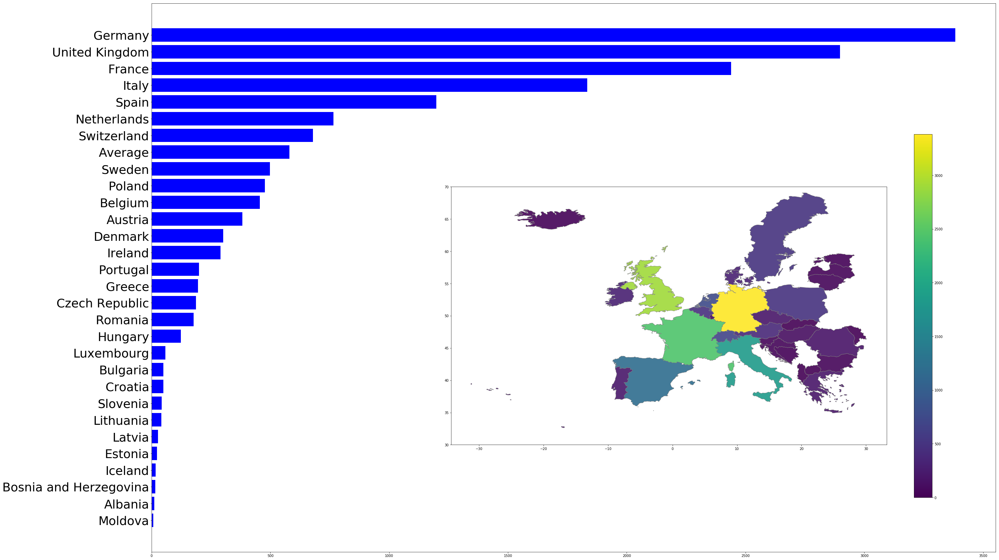

In [46]:
fig, ax1 = plt.subplots(figsize = (45,30))

left, bottom, width, height = [0.40, 0.2, 0.5, 0.5]
ax2 = fig.add_axes([left, bottom, width, height])



ax1.barh(bar_graph_df.index, bar_graph_df[2015], color = 'blue')
ax1.tick_params(axis ='y', which = 'major', labelsize = 36)
europe_map.plot(ax = ax2, # So the geopandas has a built in plot feature, we just pass our "ax to it
             edgecolor='tab:grey', # Tell it the edge color
             column=year,
             cmap="viridis",
             alpha= 0.9,
             vmin=0,
             legend=True)
ax2.set_ylim(30,70)

### The below code is a function that allows us to make a combines chart for any year for the 
### data that is provided:

In [47]:
def final_plot (y, mapmax, barmax):
    
    fig, ax1 = plt.subplots(figsize = (30,25))
    ax1.set_title (str(y), fontsize = 40)

    left, bottom, width, height = [0.40, 0.2, 0.5, 0.5]
    ax2 = fig.add_axes([left, bottom, width, height])

    ax1.barh(bar_graph_df.index, bar_graph_df[y], color = 'r')
    ax1.tick_params(axis ='both', which = 'major', labelsize = 20)
    ax1.set_xlim(0,barmax) #4500
    ax1.set_ylabel("Country", fontsize = 23,) # The ylable
    ax1.set_xlabel("GDP", fontsize = 23) # the xlable
    ax1.spines["right"].set_visible(False) # This removes the ``spines'', just the right and top
    ax1.spines["top"].set_visible(False) 
    

    europe_map.plot(ax = ax2, # So the geopandas has a built in plot feature, we just pass our "ax to it
             edgecolor='tab:grey', # Tell it the edge color
             column= y,
             cmap="OrRd",
             alpha= 0.9,
             vmin=0,
             vmax = mapmax, #3500
             legend=False)
    ax2.set_ylim(30,70)
    ax2.spines["right"].set_visible(False) # This removes the ``spines'', just the right and top
    ax2.spines["top"].set_visible(False) 



    plt.savefig(finaloutput+ str(y))

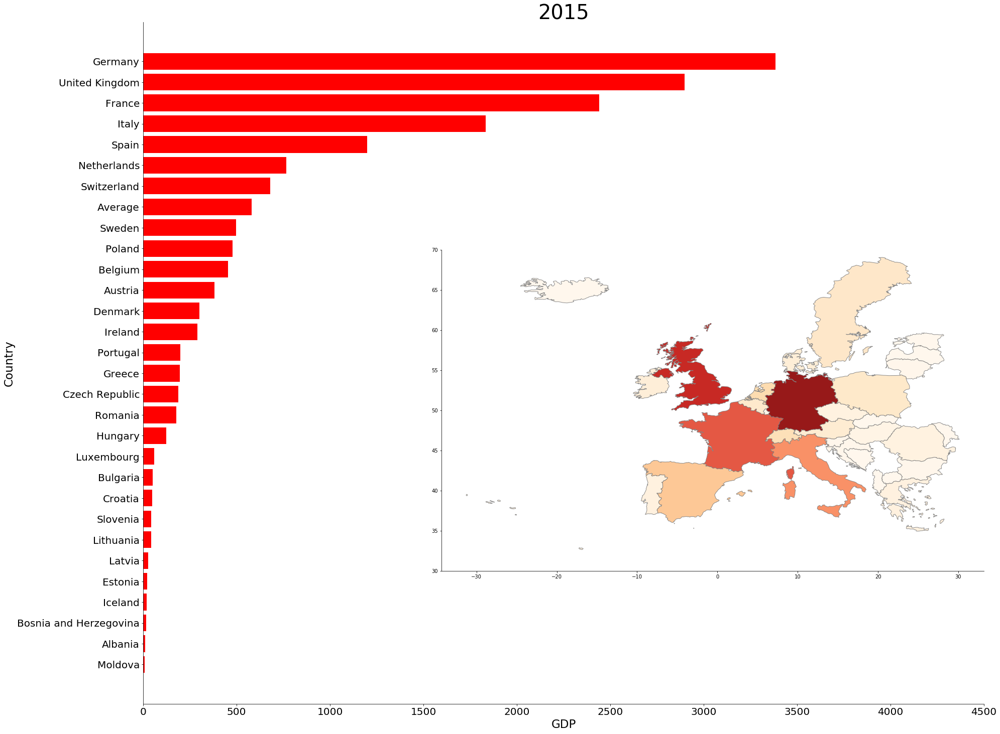

In [48]:
sort_barchart(2015)
final_plot(2015, 3500, 4500)

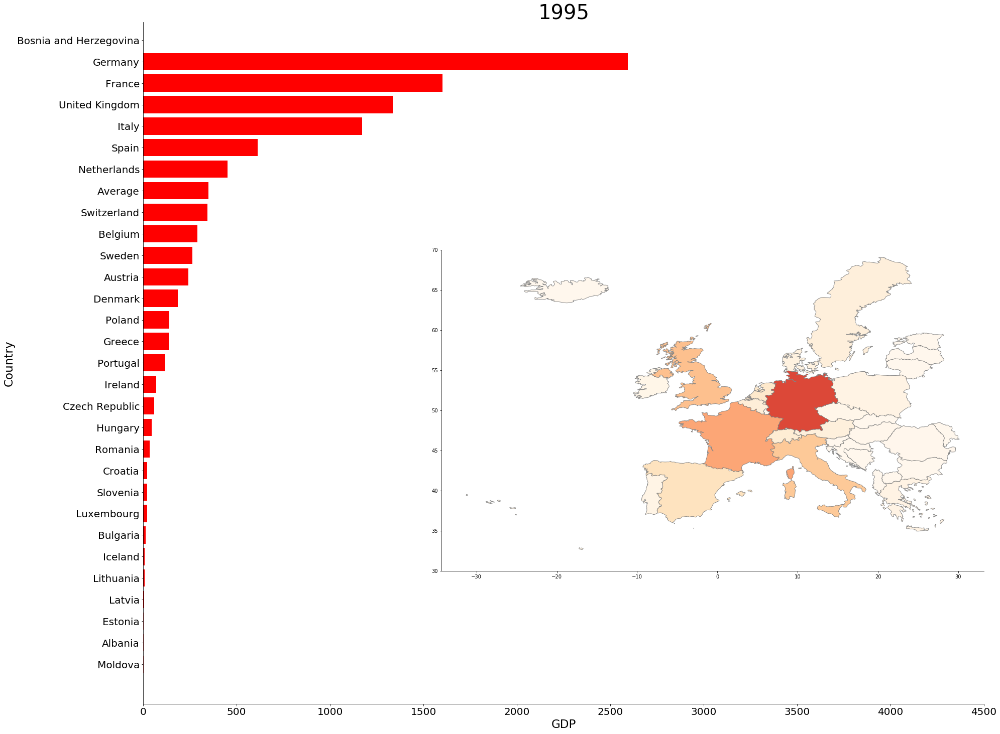

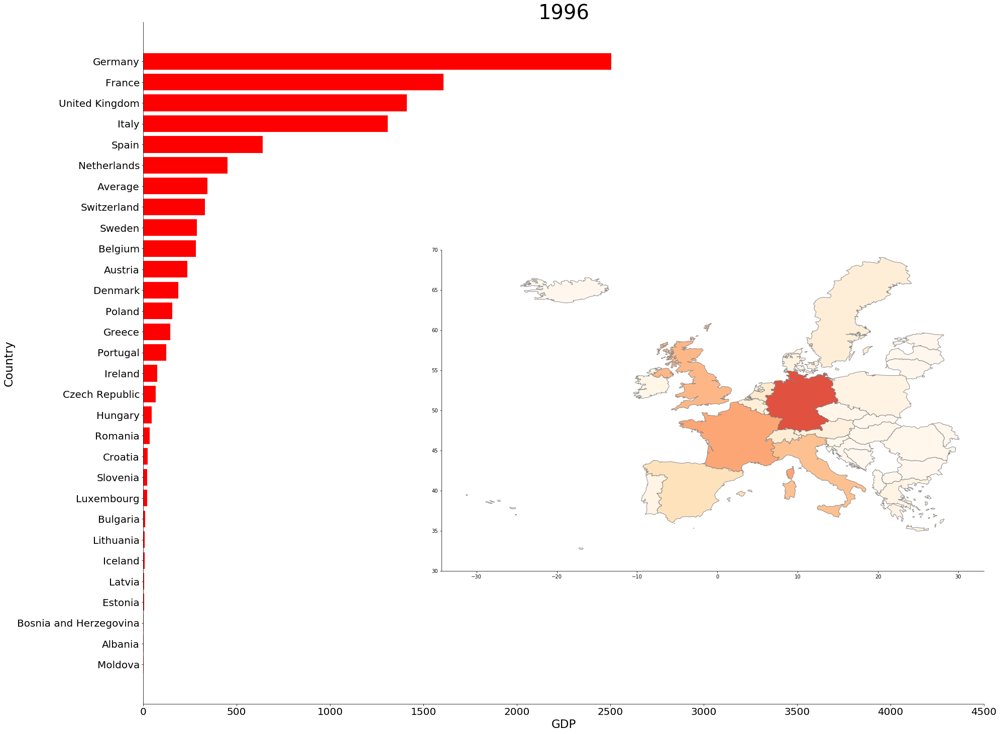

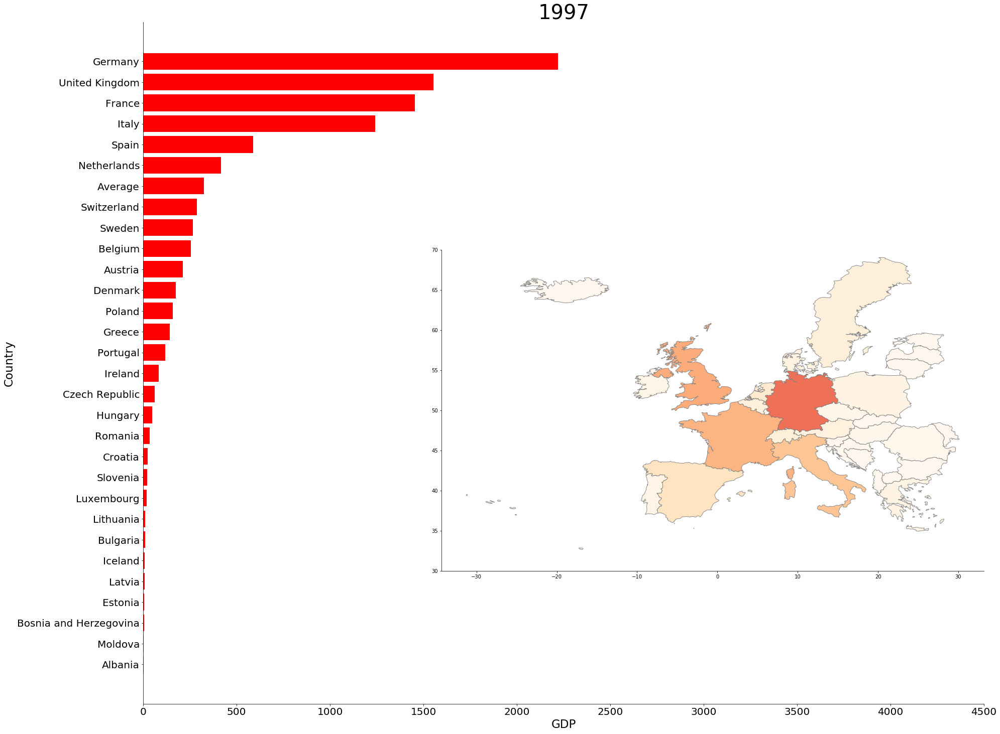

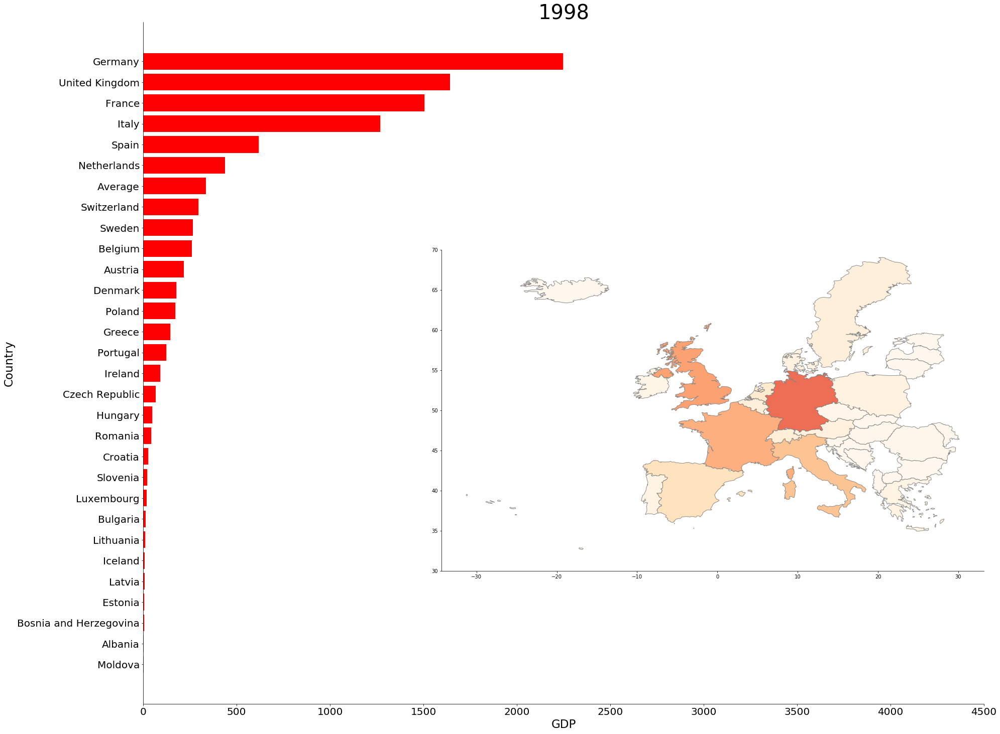

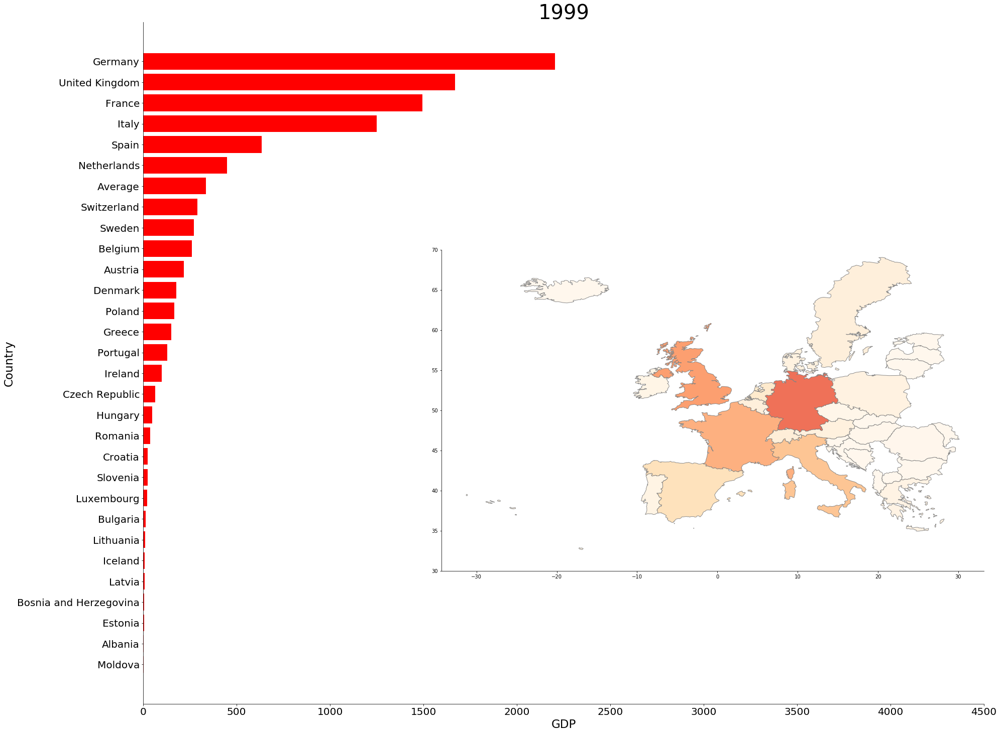

...

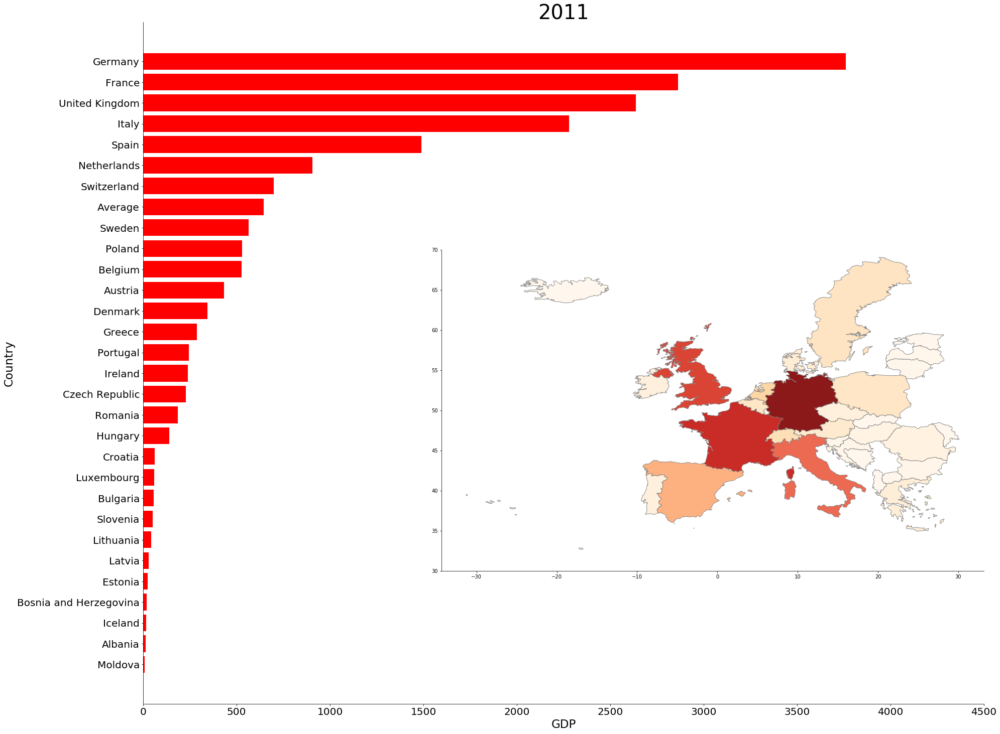

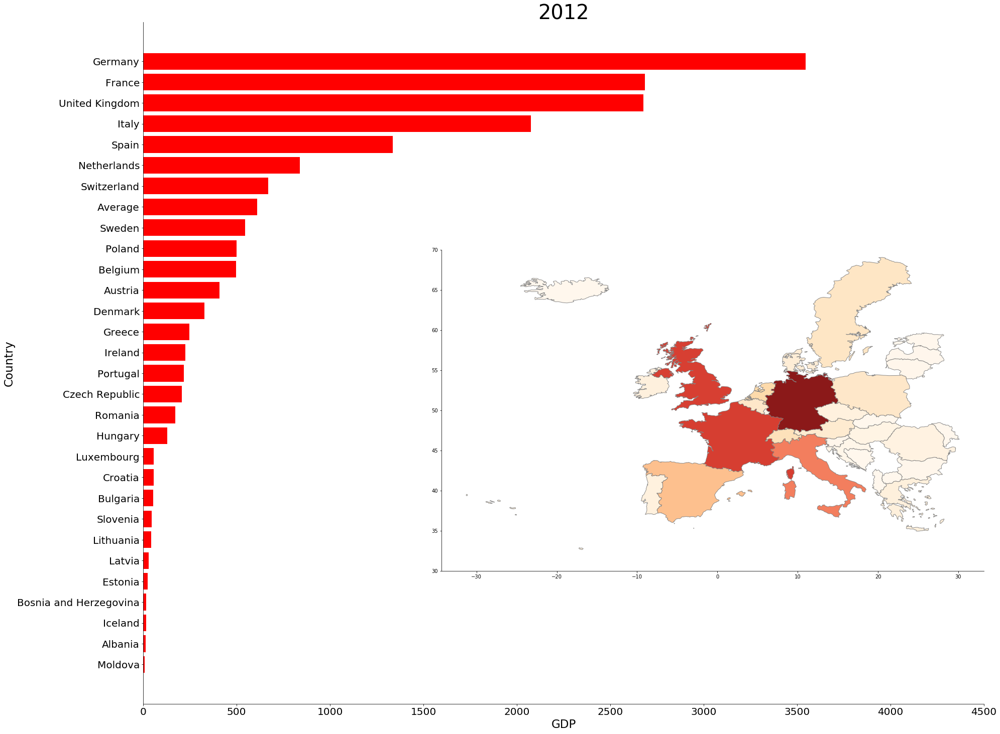

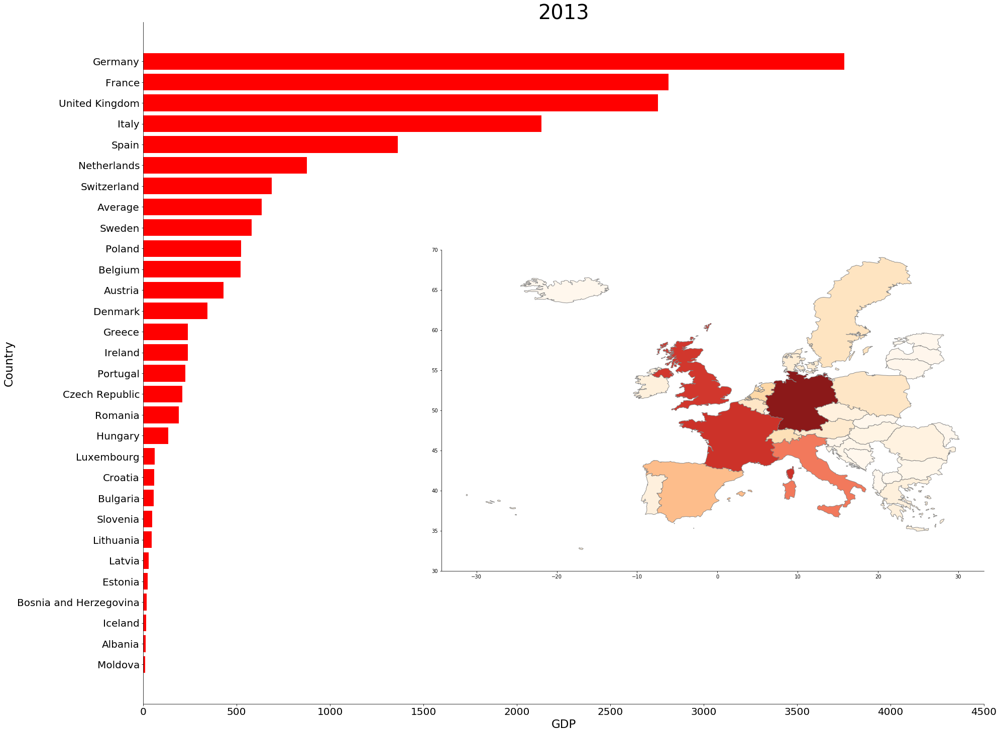

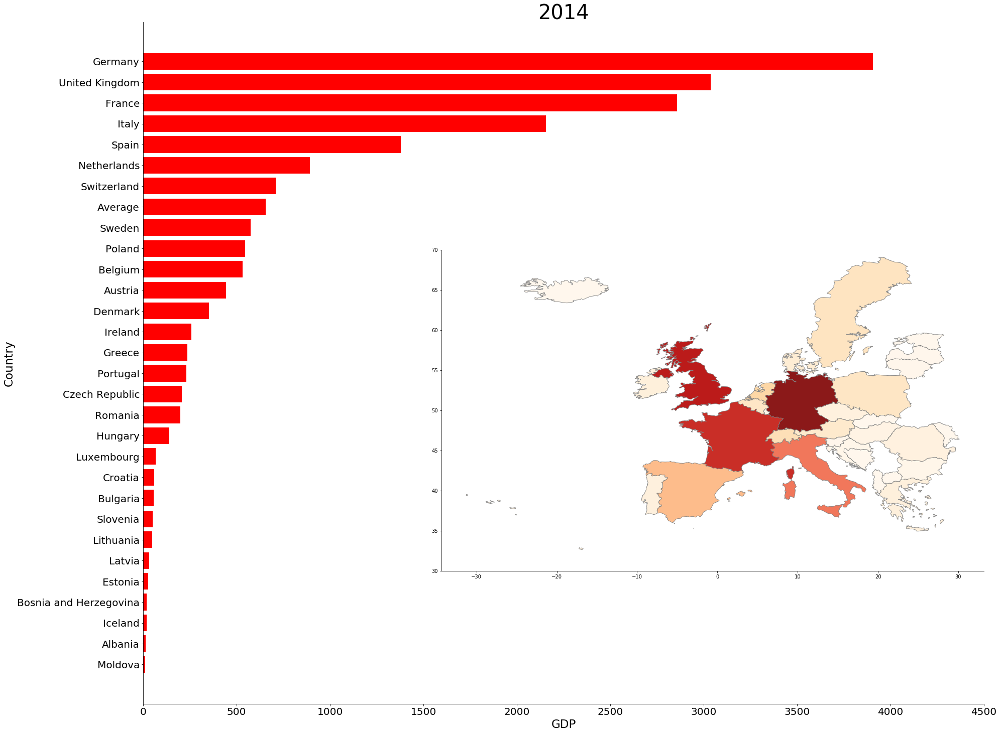

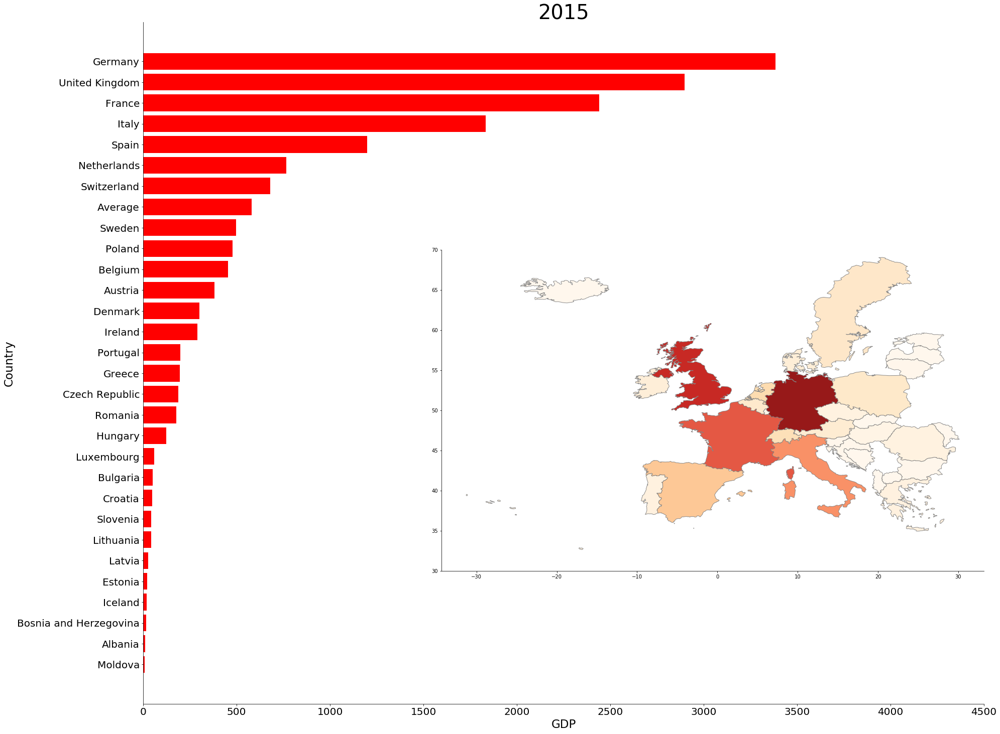

In [49]:
for year in year_list:
    sort_barchart(year)
    final_plot(year, 3500,4500)

In [50]:
fimages = []

In [51]:
for filename in year_pic_list:
    fimages.append(imageio.imread(os.getcwd() + "/FinalOutput/" + filename))
    imageio.mimsave(finaloutputgif, fimages, duration = 1)

### Now I will look at the natural log of the GDP data and plot that out:

In [52]:
year_log_list = []

for year in year_list:
    year_log_list.append(str(year)+" log")

In [53]:
year_log_list

['1995 log',
 '1996 log',
 '1997 log',
 '1998 log',
 '1999 log',
 '2000 log',
 '2001 log',
 '2002 log',
 '2003 log',
 '2004 log',
 '2005 log',
 '2006 log',
 '2007 log',
 '2008 log',
 '2009 log',
 '2010 log',
 '2011 log',
 '2012 log',
 '2013 log',
 '2014 log',
 '2015 log']

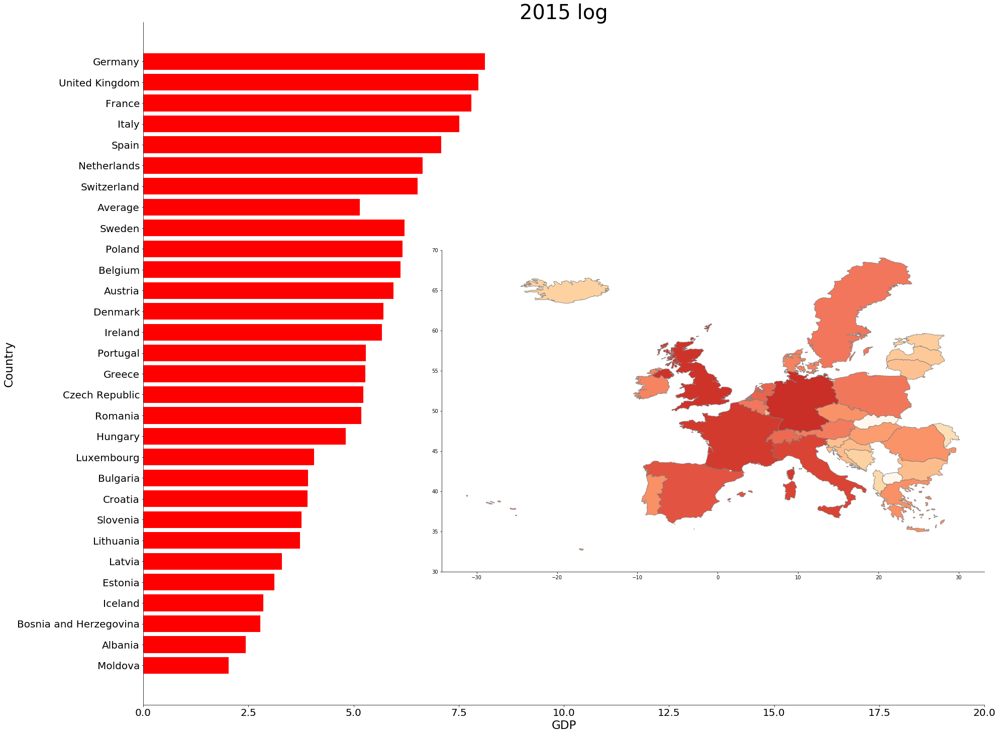

In [54]:
final_plot("2015 log", 10,20)

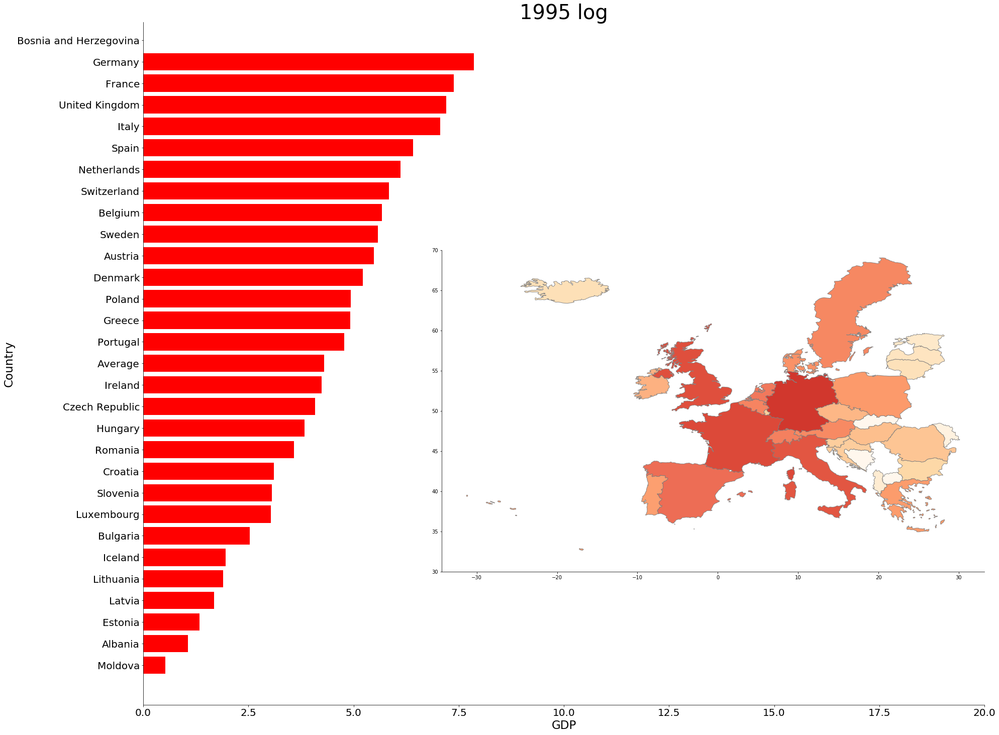

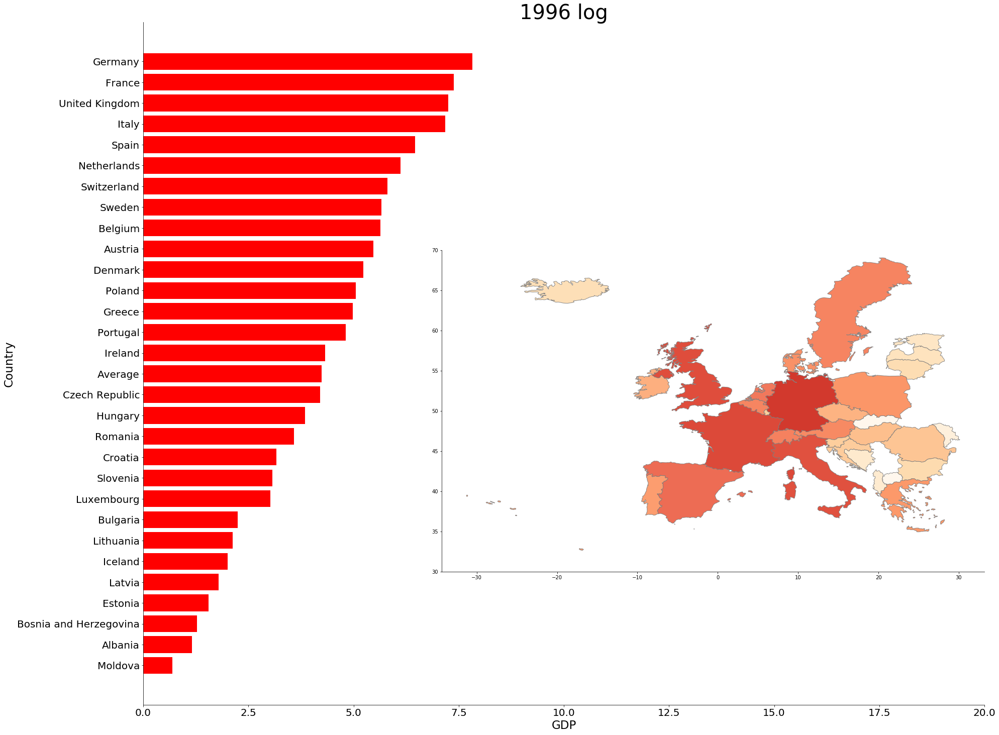

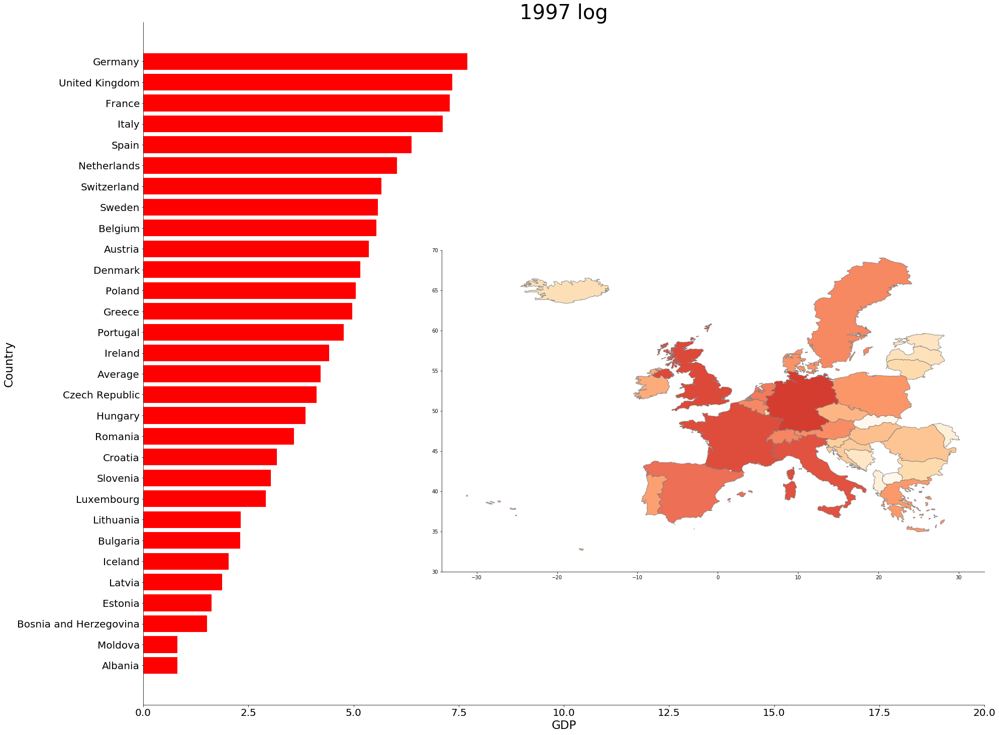

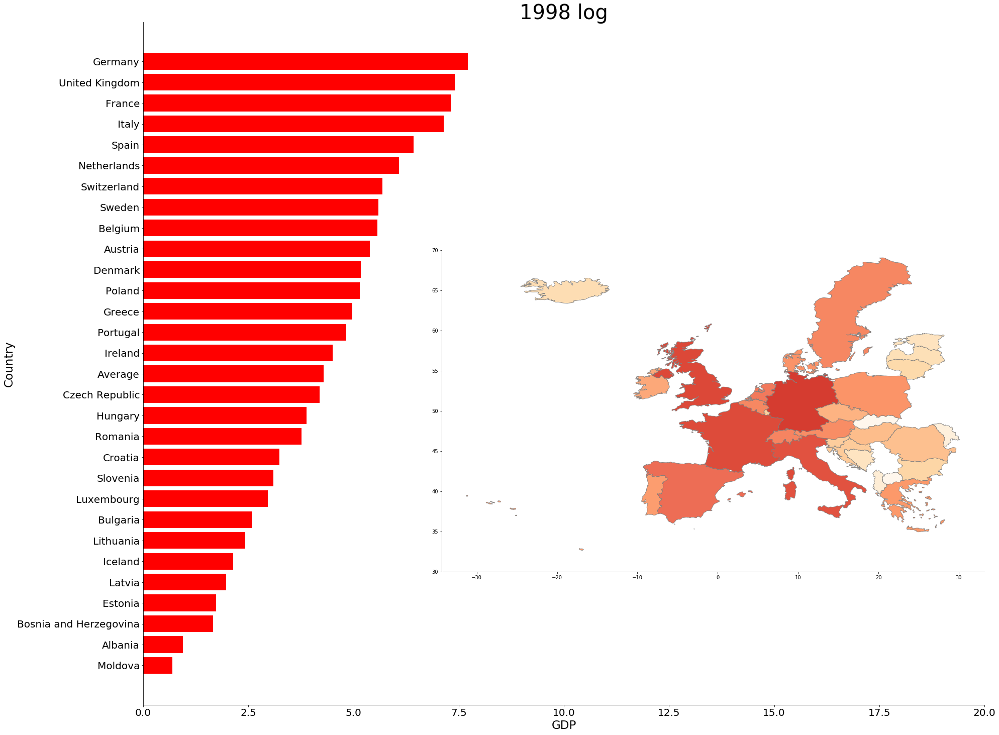

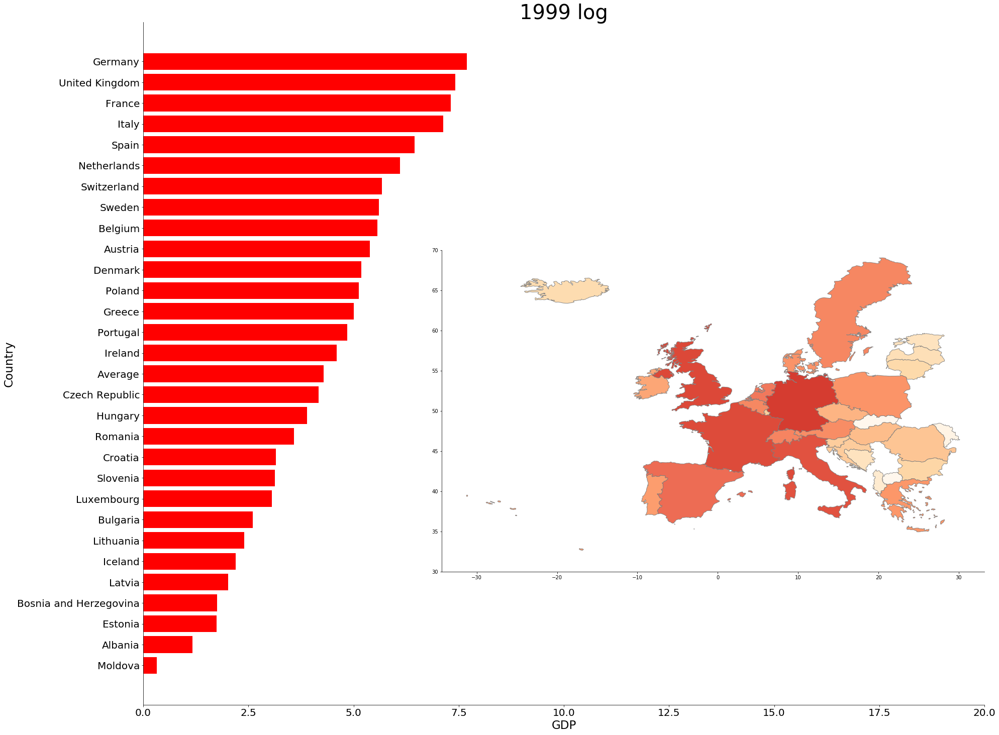

...

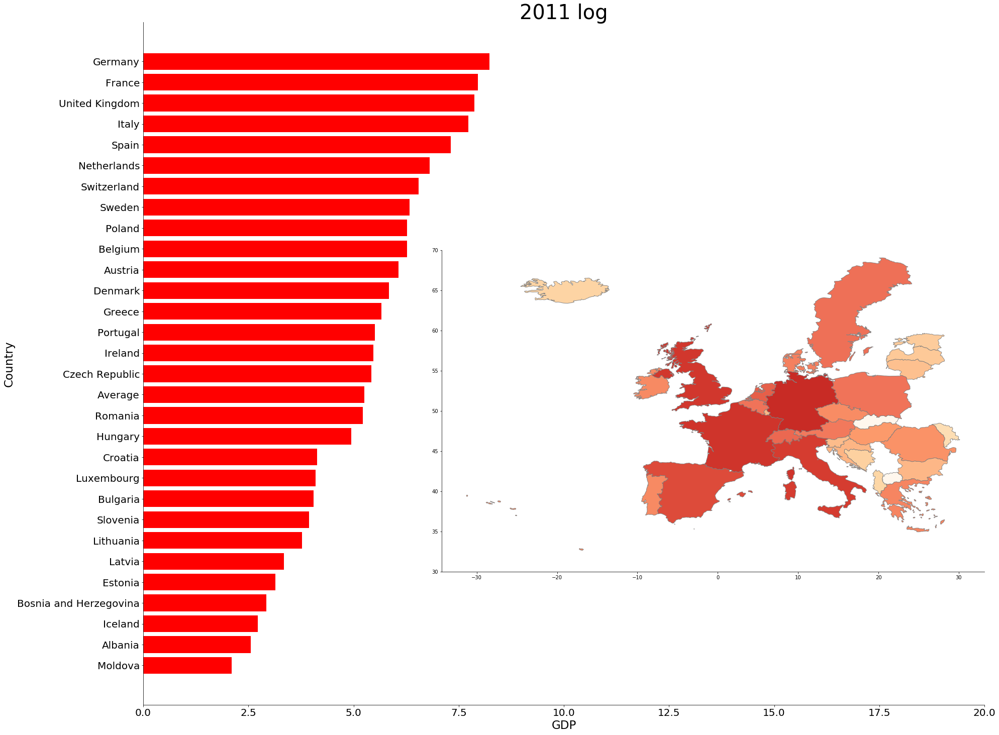

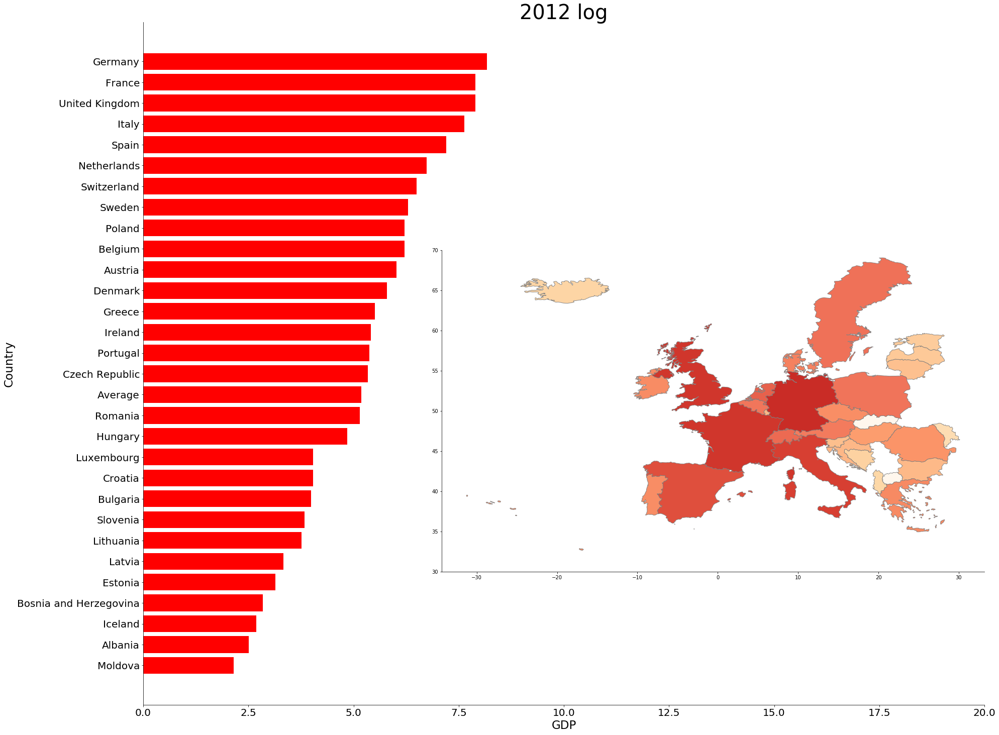

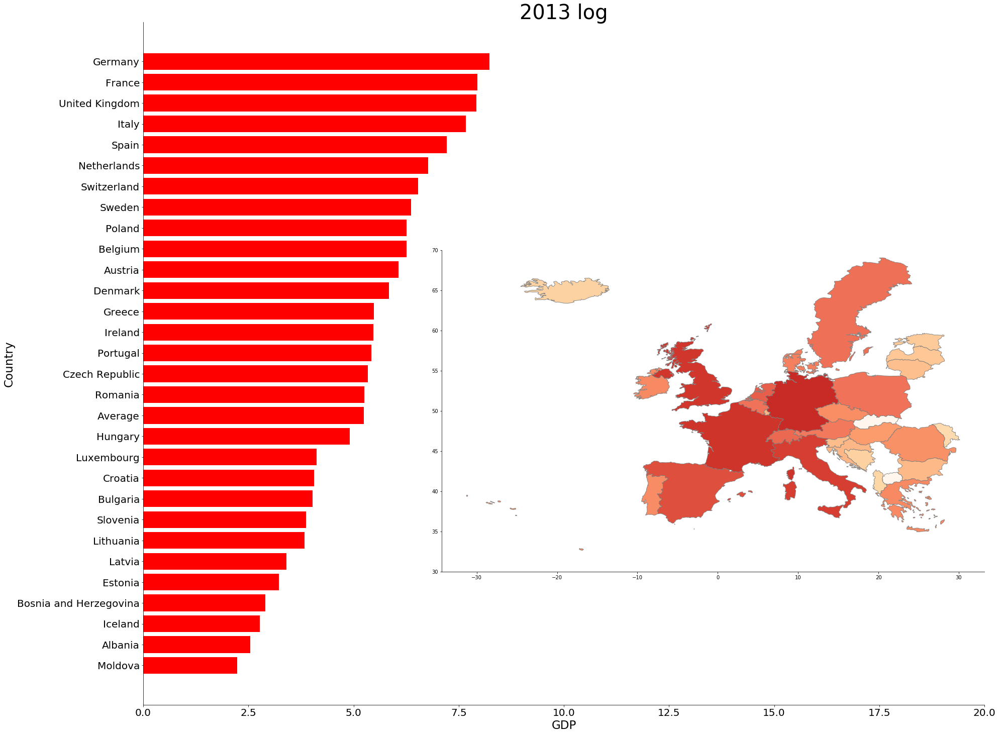

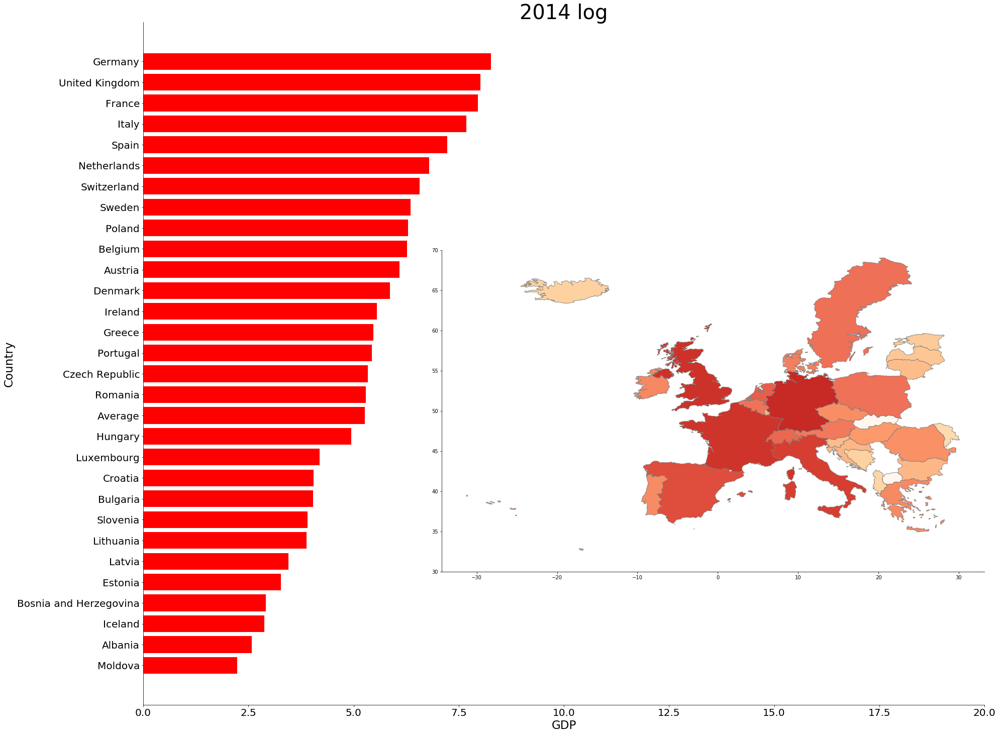

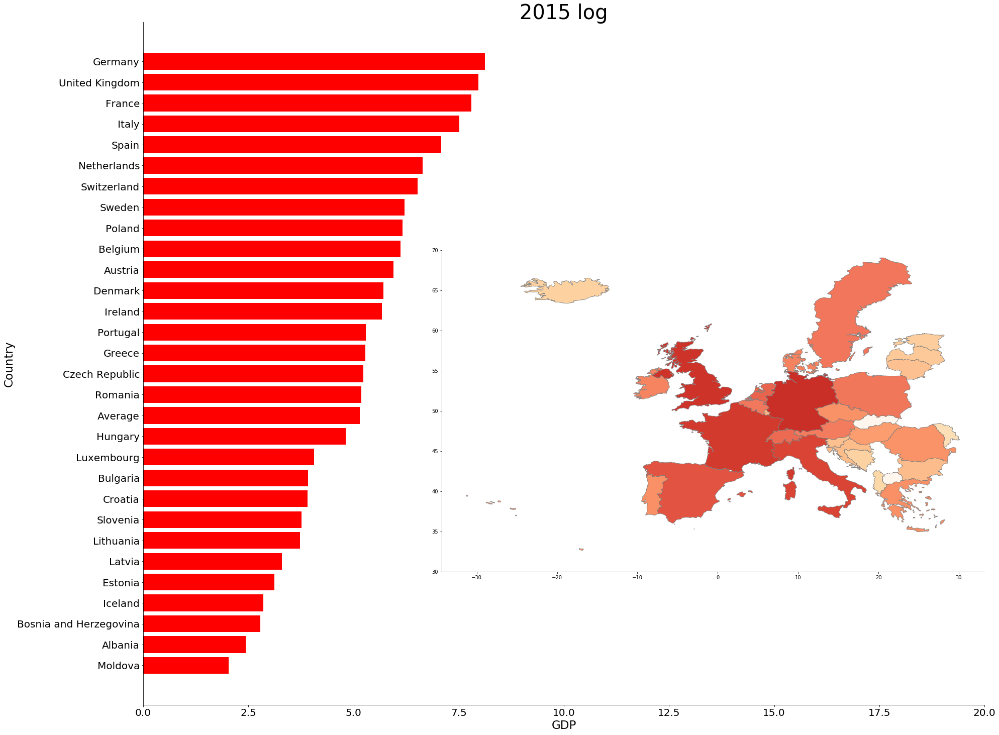

In [55]:
for year in year_log_list:
    sort_barchart(year)
    final_plot(year, 10,20)

In [56]:
year_pic_log_list = []

for year in year_log_list:
    year_pic_log_list.append(str(year)+".png")

In [85]:
logimages = []

In [86]:
for filename in year_pic_log_list:
    logimages.append(imageio.imread(os.getcwd() + "/FinalOutput/" + filename))
    imageio.mimsave(finaloutputgdplog, logimages, duration = 1)

### Below, I will read in and clean up the data for GDP per Capita because as I was going through the project
### I realized that GDP per Capita might show a better picture of how GDP in Europe changed through the several
### economic changes that occured in the area:

In [59]:
gdp_per_capita_data = pd.read_excel(per_capita_file_name)

In [60]:
gdp_per_capita_data

,Country,Subject Descriptor,Units,Scale,Country/Series-specific Notes,1995,1996,1997,1998,1999,...,2007,2008,2009,2010,2011,2012,2013,2014,2015,Estimates Start After
0,Afghanistan,"Gross domestic product per capita, current prices",U.S. dollars,Units,"See notes for: Gross domestic product, curren...",NaN,NaN,NaN,NaN,NaN,...,321.441,377.256,430.867,532.072,602.183,661.087,635.635,629.332,594.513,2016.0
1,Albania,"Gross domestic product per capita, current prices",U.S. dollars,Units,"See notes for: Gross domestic product, curren...",903.989,1009.967,717.381,818.320,1032.264,...,3594.101,4377.040,4130.929,4098.125,4438.925,4248.814,4422.674,4575.416,3944.876,2016.0
2,Algeria,"Gross domestic product per capita, current prices",U.S. dollars,Units,"See notes for: Gross domestic product, curren...",1499.143,1643.265,1658.732,1633.090,1630.071,...,3986.564,4943.502,3886.059,4480.719,5453.894,5574.507,5477.055,5466.329,4153.322,2017.0
3,Angola,"Gross domestic product per capita, current prices",U.S. dollars,Units,"See notes for: Gross domestic product, curren...",419.529,525.403,599.077,493.041,452.677,...,3099.087,4081.688,3146.802,3641.444,4716.253,5245.023,5436.516,5625.736,4354.921,2015.0
4,Antigua and Barbuda,"Gross domestic product per capita, current prices",U.S. dollars,Units,"See notes for: Gross domestic product, curren...",8675.225,9266.488,9678.300,10074.768,10349.505,...,15996.056,16514.078,14616.947,13613.471,13346.768,14006.820,13646.242,14436.522,15219.198,2011.0
5,Argentina,"Gross domestic product per capita, current prices",U.S. dollars,Units,"See notes for: Gross domestic product, curren...",8053.119,8385.153,8918.826,9005.377,8452.876,...,7315.726,9146.790,8337.811,10412.945,12787.806,13889.792,14488.829,13208.831,14895.316,2017.0
6,Armenia,"Gross domestic product per capita, current prices",U.S. dollars,Units,"See notes for: Gross domestic product, curren...",399.576,503.774,521.869,608.415,597.241,...,3079.031,3913.436,2911.763,3121.778,3417.172,3575.529,3732.035,3889.004,3529.026,2015.0
7,Aruba,"Gross domestic product per capita, current prices",U.S. dollars,Units,"See notes for: Gross domestic product, curren...",16546.617,16620.854,17751.072,18825.012,19215.013,...,26114.088,27204.889,24594.675,23468.600,24801.812,24236.809,24253.141,24599.296,24686.161,2017.0
8,Australia,"Gross domestic product per capita, current prices",U.S. dollars,Units,"See notes for: Gross domestic product, curren...",20868.045,23106.852,22990.441,20346.819,21726.343,...,45105.410,49151.941,45685.238,56453.828,67222.144,68436.219,65170.853,61652.281,51493.961,2018.0
9,Austria,"Gross domestic product per capita, current prices",U.S. dollars,Units,"See notes for: Gross domestic product, curren...",30350.546,29820.613,26737.482,27399.085,27209.314,...,46922.423,51953.557,48095.397,46958.519,51441.105,48615.817,50748.087,51814.366,44266.411,2017.0


In [61]:
gdp_per_capita_data = gdp_per_capita_data.drop(["Subject Descriptor","Units","Scale","Country/Series-specific Notes"], axis=1)

In [62]:
gdp_per_capita_data = gdp_per_capita_data.set_index("Country")

In [63]:
gdp_per_capita_data

,1995,1996,1997,1998,1999,2000,2001,2002,2003,2004,...,2007,2008,2009,2010,2011,2012,2013,2014,2015,Estimates Start After
Country,,,,,,,,,,,,,,,,,,,,,
Afghanistan,NaN,NaN,NaN,NaN,NaN,NaN,NaN,196.683,196.954,214.230,...,321.441,377.256,430.867,532.072,602.183,661.087,635.635,629.332,594.513,2016.0
Albania,903.989,1009.967,717.381,818.320,1032.264,1127.640,1283.573,1425.125,1846.119,2373.580,...,3594.101,4377.040,4130.929,4098.125,4438.925,4248.814,4422.674,4575.416,3944.876,2016.0
Algeria,1499.143,1643.265,1658.732,1633.090,1630.071,1794.695,1768.577,1806.860,2128.385,2636.309,...,3986.564,4943.502,3886.059,4480.719,5453.894,5574.507,5477.055,5466.329,4153.322,2017.0
Angola,419.529,525.403,599.077,493.041,452.677,652.110,619.697,841.420,951.969,1222.038,...,3099.087,4081.688,3146.802,3641.444,4716.253,5245.023,5436.516,5625.736,4354.921,2015.0
Antigua and Barbuda,8675.225,9266.488,9678.300,10074.768,10349.505,10981.376,10414.643,10482.368,10893.152,11582.523,...,15996.056,16514.078,14616.947,13613.471,13346.768,14006.820,13646.242,14436.522,15219.198,2011.0
Argentina,8053.119,8385.153,8918.826,9005.377,8452.876,8386.587,7851.658,2898.289,3648.061,4314.397,...,7315.726,9146.790,8337.811,10412.945,12787.806,13889.792,14488.829,13208.831,14895.316,2017.0
Armenia,399.576,503.774,521.869,608.415,597.241,620.638,692.287,779.122,923.387,1180.399,...,3079.031,3913.436,2911.763,3121.778,3417.172,3575.529,3732.035,3889.004,3529.026,2015.0
Aruba,16546.617,16620.854,17751.072,18825.012,19215.013,20678.398,20909.299,21081.787,21704.381,23421.303,...,26114.088,27204.889,24594.675,23468.600,24801.812,24236.809,24253.141,24599.296,24686.161,2017.0
Australia,20868.045,23106.852,22990.441,20346.819,21726.343,20851.865,19431.456,21644.925,27222.017,32750.675,...,45105.410,49151.941,45685.238,56453.828,67222.144,68436.219,65170.853,61652.281,51493.961,2018.0


In [64]:
for year in year_list:
    bar_graph_df[str(year) + " per capita"] = gdp_per_capita_data[year]

In [65]:
bar_graph_df.loc['Average']=bar_graph_df.mean()

In [66]:
for year in year_list:
    europe_map[str(year) + " per capita"] = gdp_per_capita_data[year]

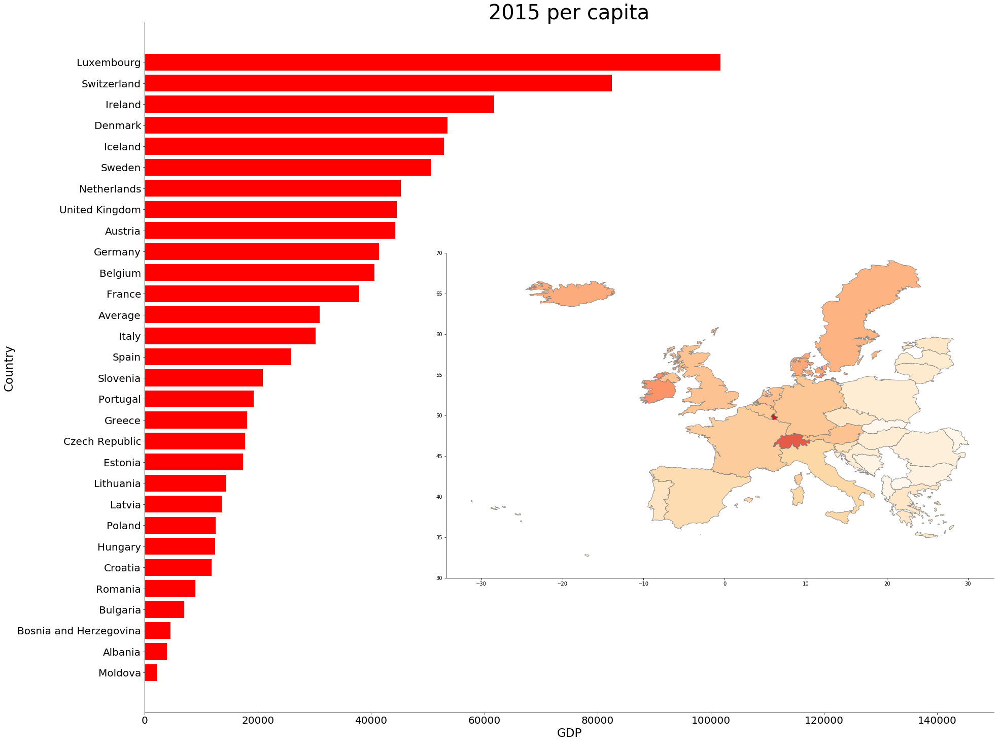

In [67]:
sort_barchart("2015 per capita")
final_plot("2015 per capita", 120000,150000)

In [68]:
year_per_capita_list = []

for year in year_list:
    year_per_capita_list.append(str(year)+" per capita")

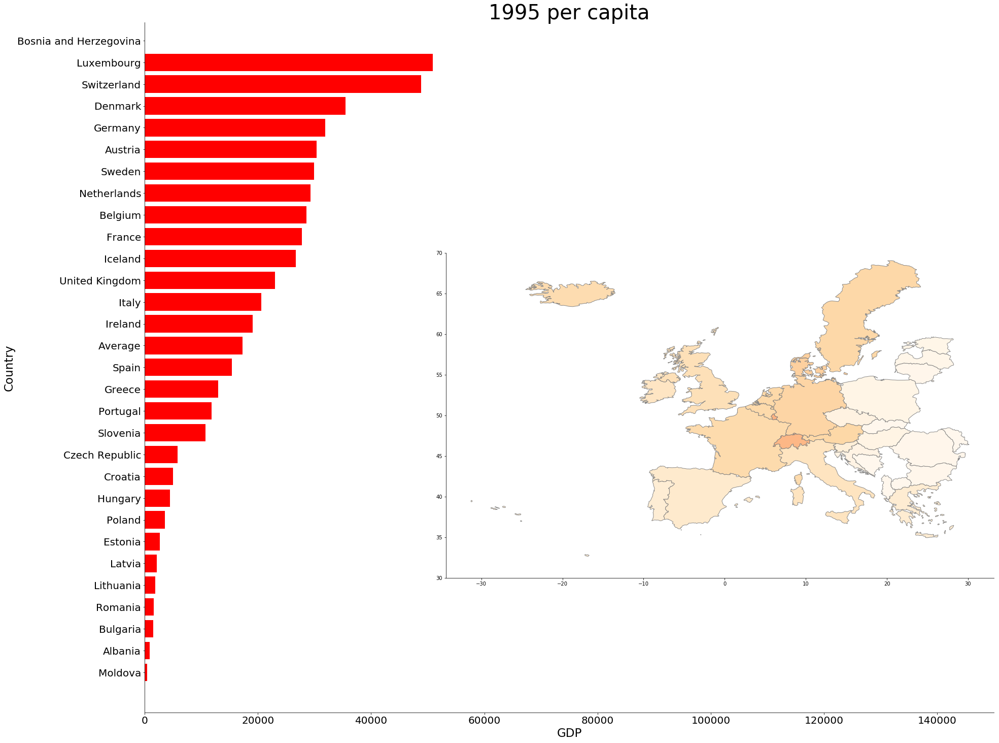

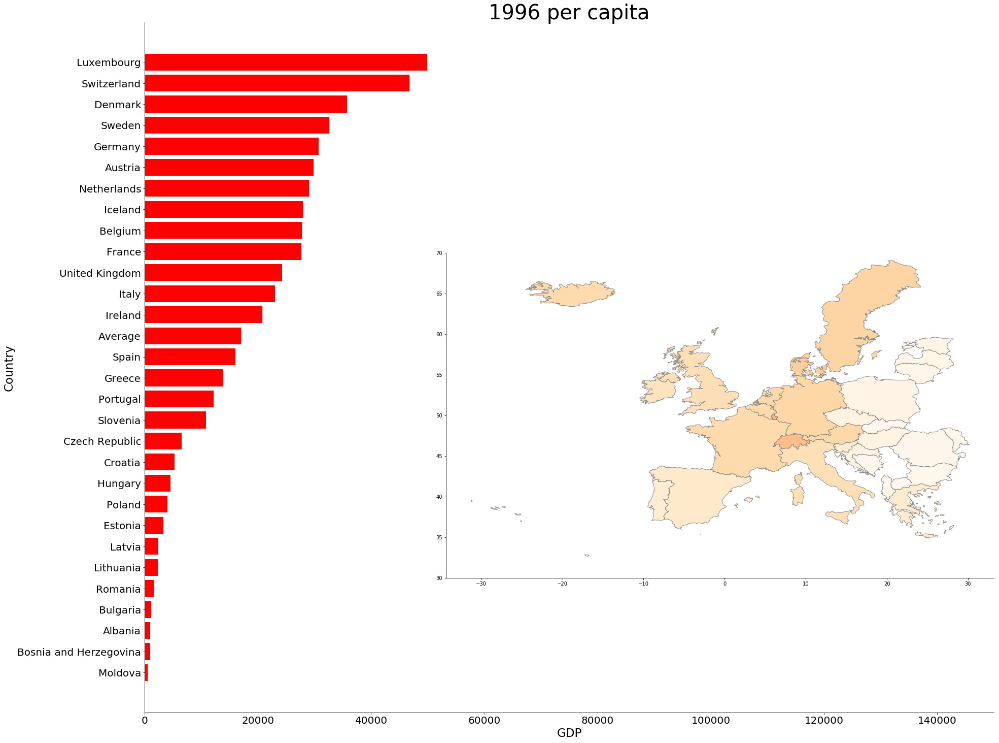

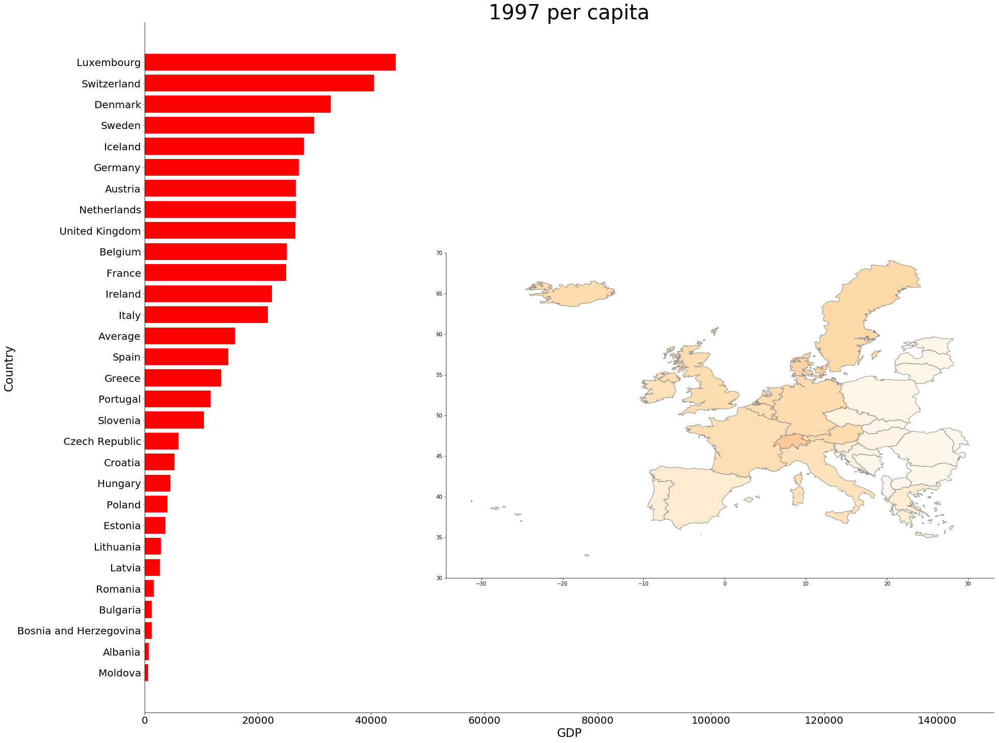

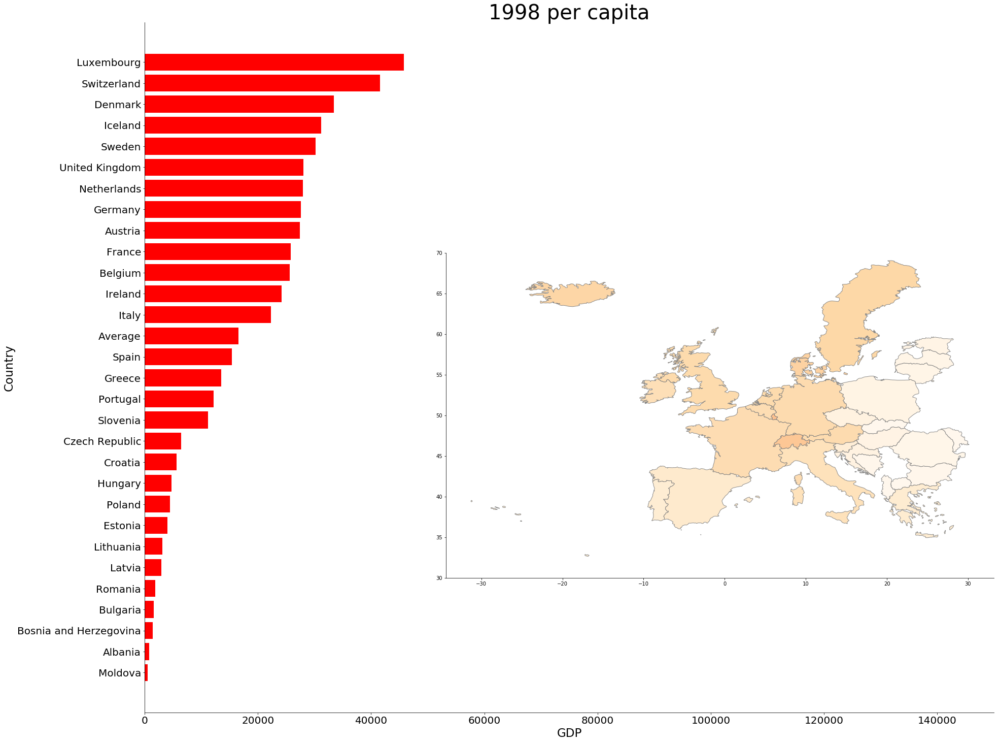

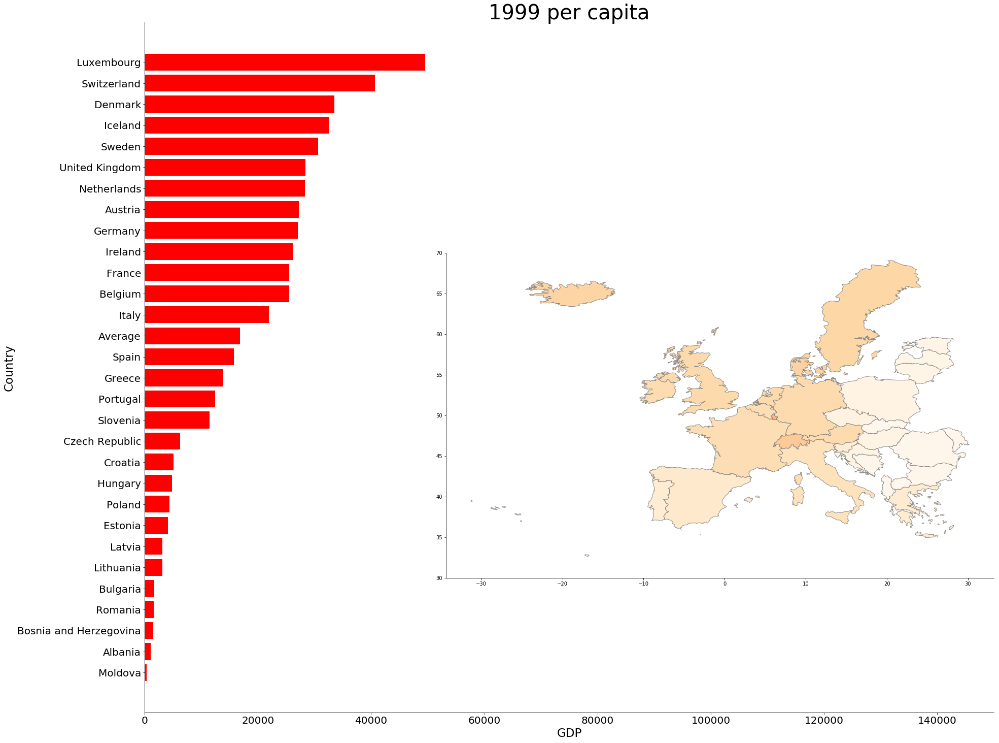

...

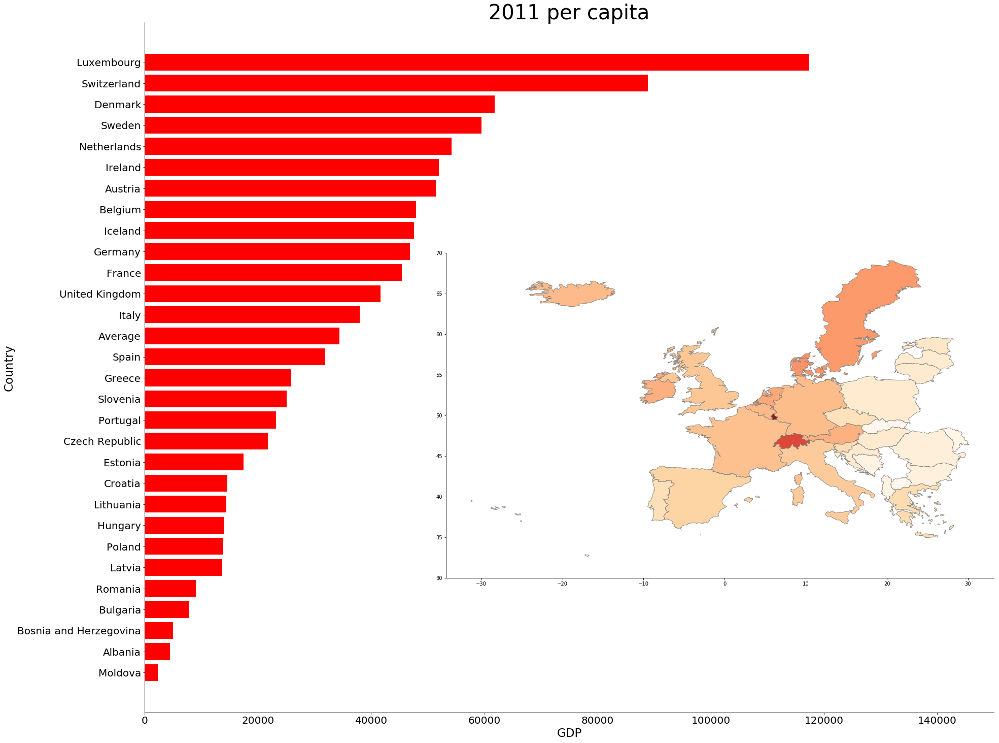

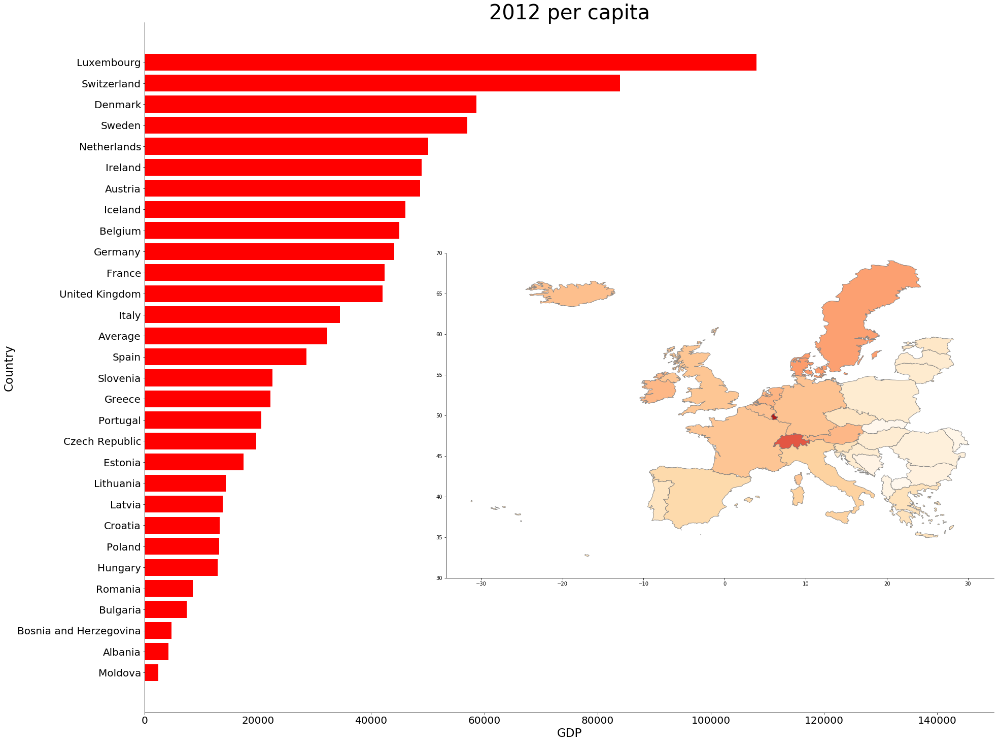

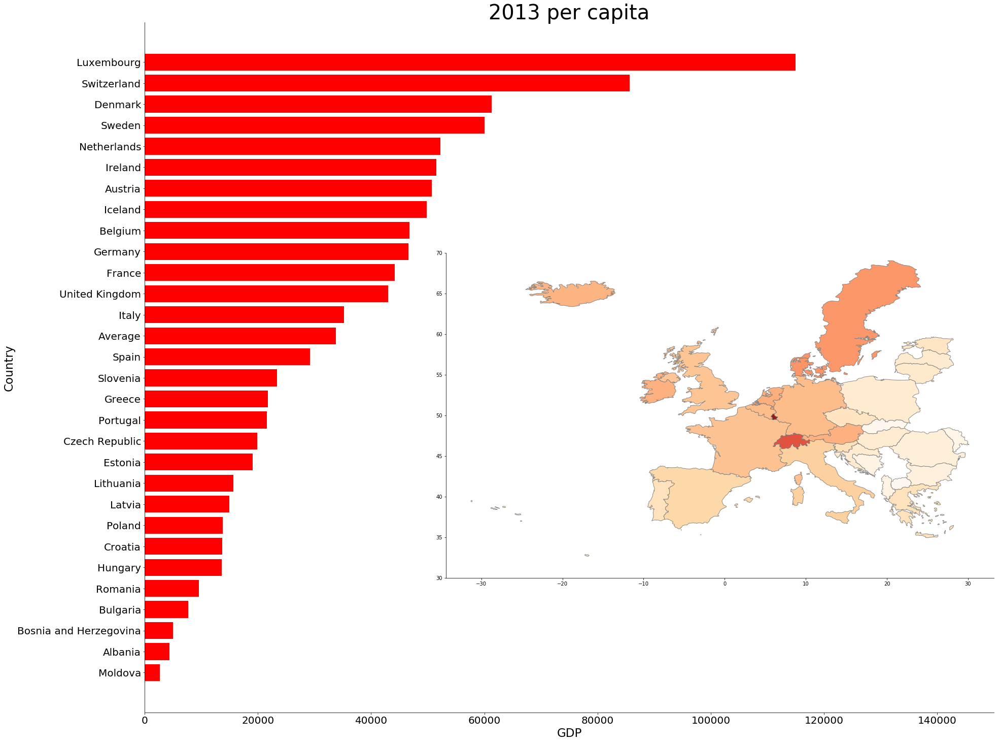

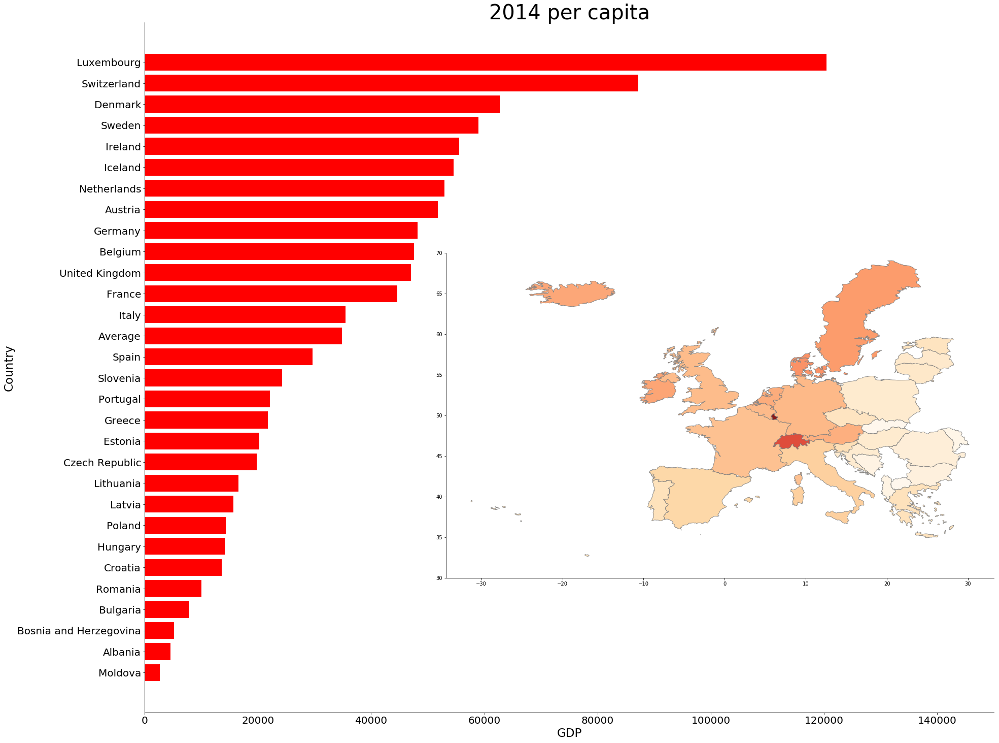

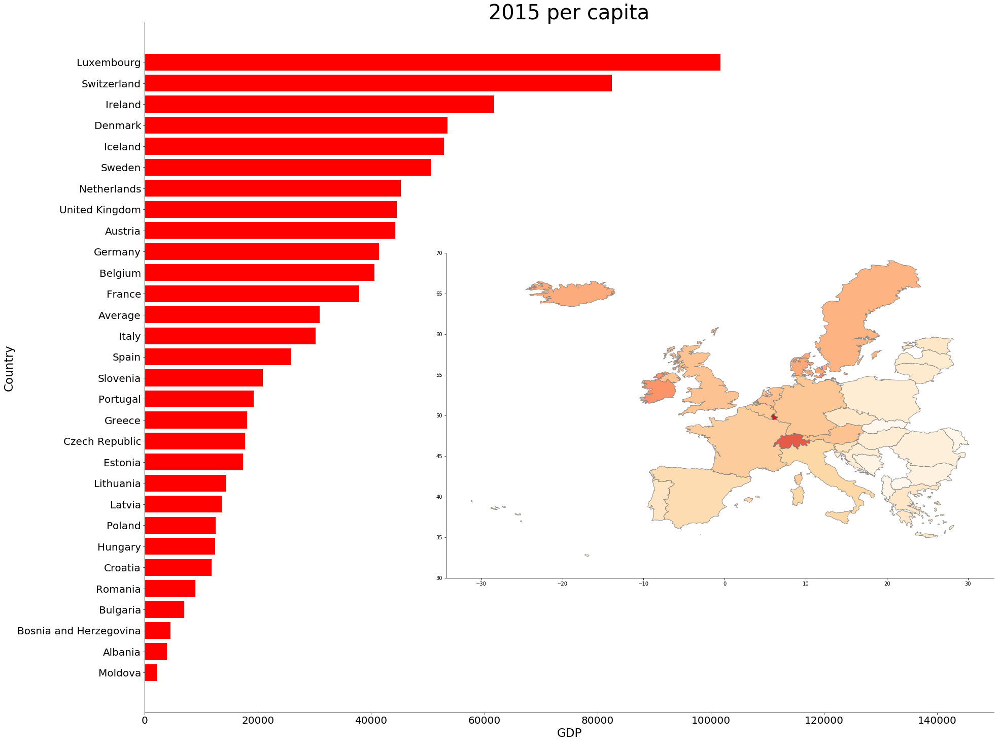

In [69]:
for year in year_per_capita_list:
    sort_barchart(year)
    final_plot(year, 120000,150000)

In [70]:
per_capita_pic_list = []

for year in year_per_capita_list:
    per_capita_pic_list.append(str(year)+".png")

In [71]:
year_list

[1995,
 1996,
 1997,
 1998,
 1999,
 2000,
 2001,
 2002,
 2003,
 2004,
 2005,
 2006,
 2007,
 2008,
 2009,
 2010,
 2011,
 2012,
 2013,
 2014,
 2015]

In [72]:
pcimages = []

In [73]:
for filename in per_capita_pic_list:
    pcimages.append(imageio.imread(os.getcwd() + "/FinalOutput/" + filename))
    imageio.mimsave(finaloutputpercapitagif, pcimages, duration = 1)

### Below, I will be charting the log of the GDP per Capita data:

In [74]:
year_per_capita_list

['1995 per capita',
 '1996 per capita',
 '1997 per capita',
 '1998 per capita',
 '1999 per capita',
 '2000 per capita',
 '2001 per capita',
 '2002 per capita',
 '2003 per capita',
 '2004 per capita',
 '2005 per capita',
 '2006 per capita',
 '2007 per capita',
 '2008 per capita',
 '2009 per capita',
 '2010 per capita',
 '2011 per capita',
 '2012 per capita',
 '2013 per capita',
 '2014 per capita',
 '2015 per capita']

In [75]:
for year in year_list:
    europe_map[str(year) + " per capita log"] = np.log(gdp_per_capita_data[year])

In [76]:
year_per_capita_log_list = []

for year in year_list:
    year_per_capita_log_list.append(str(year)+" per capita log")

In [77]:
for year in year_list:
    bar_graph_df[str(year) + " per capita log"] = np.log(gdp_per_capita_data[year])

In [78]:
bar_graph_df.loc['Average']=bar_graph_df.mean()

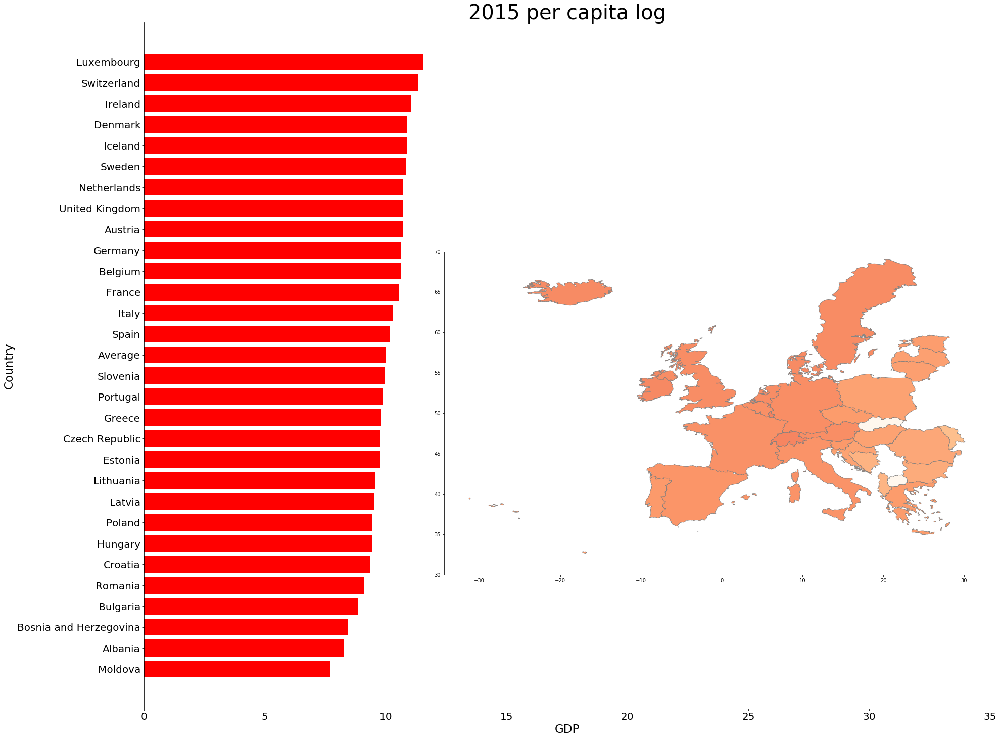

In [79]:
sort_barchart("2015 per capita log")
final_plot("2015 per capita log", 20,35)

In [80]:
year_per_capita_log_list = []

for year in year_list:
    year_per_capita_log_list.append(str(year)+" per capita log")

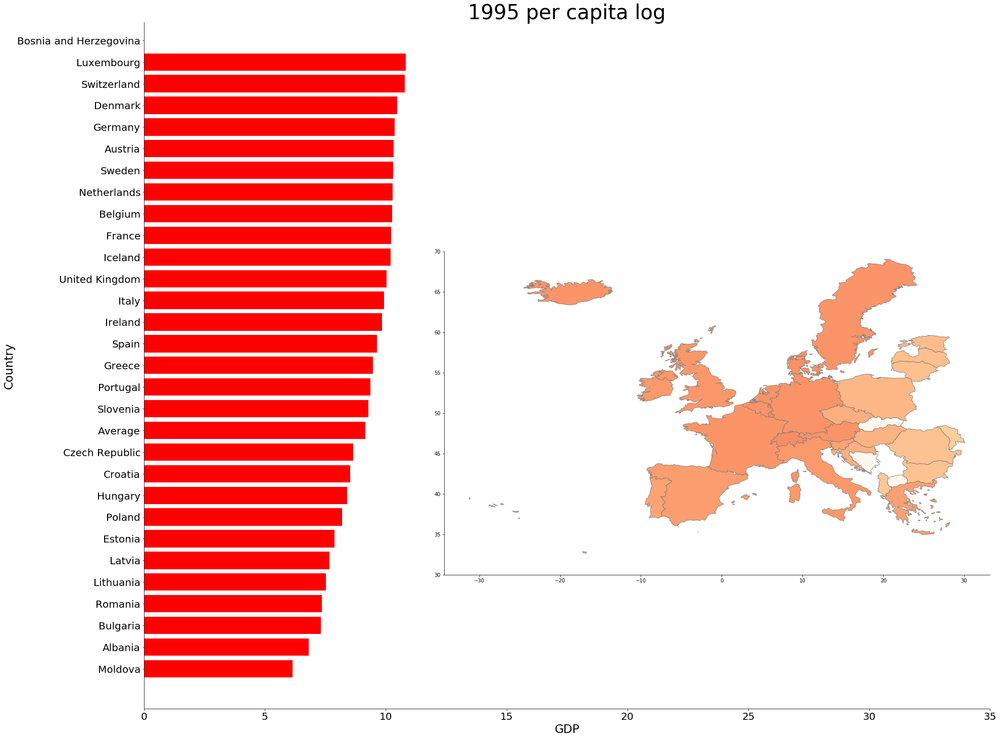

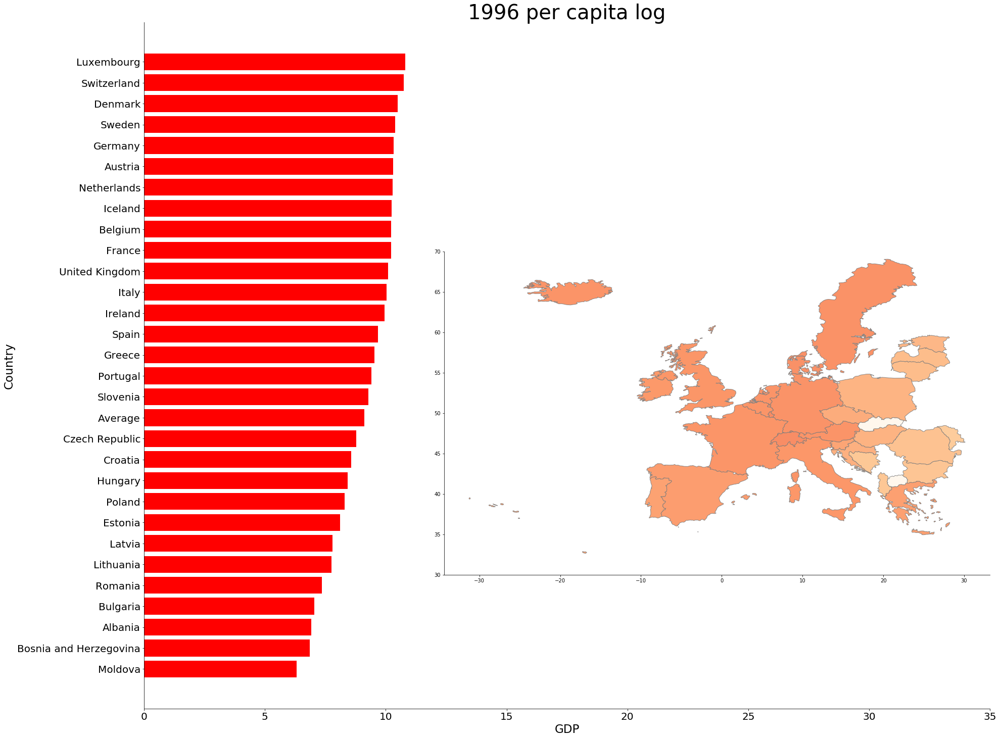

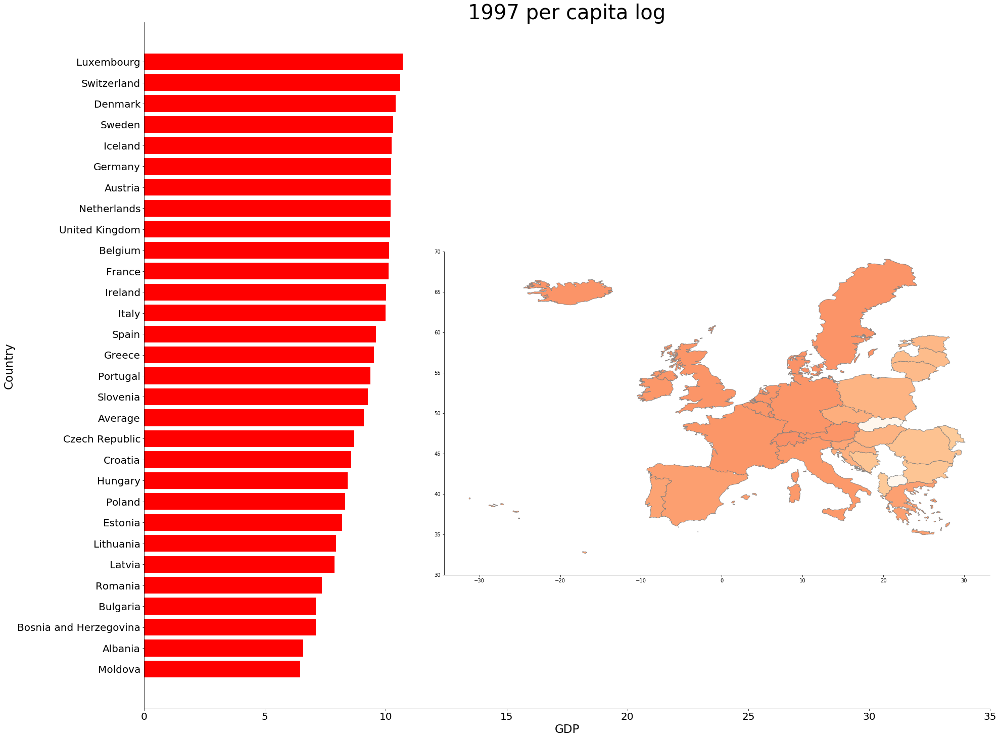

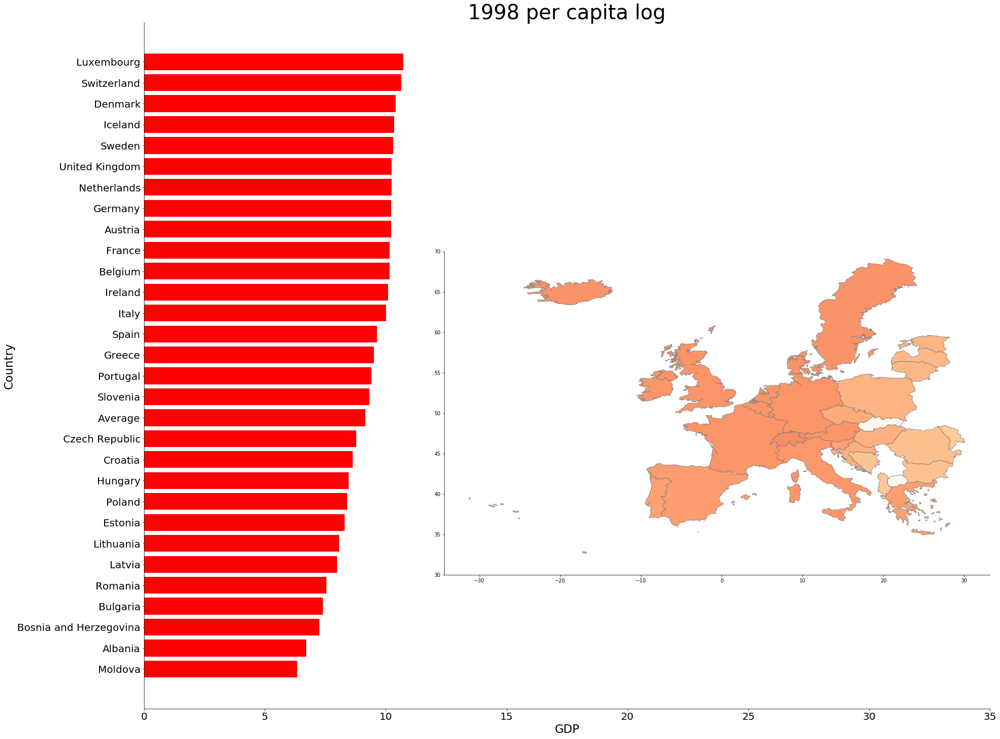

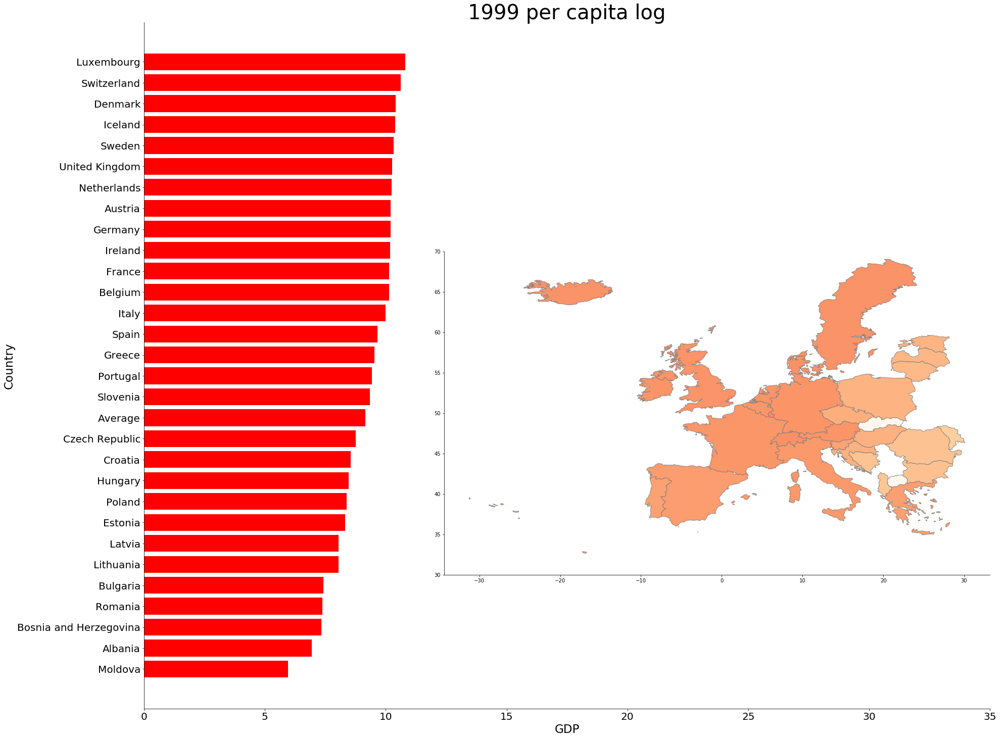

...

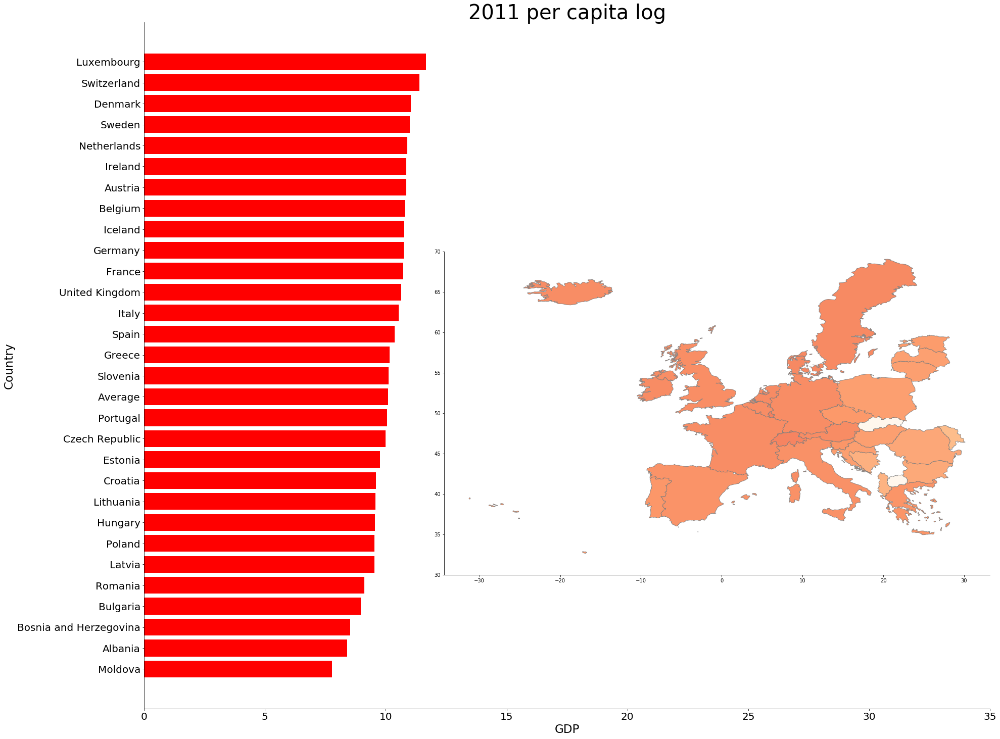

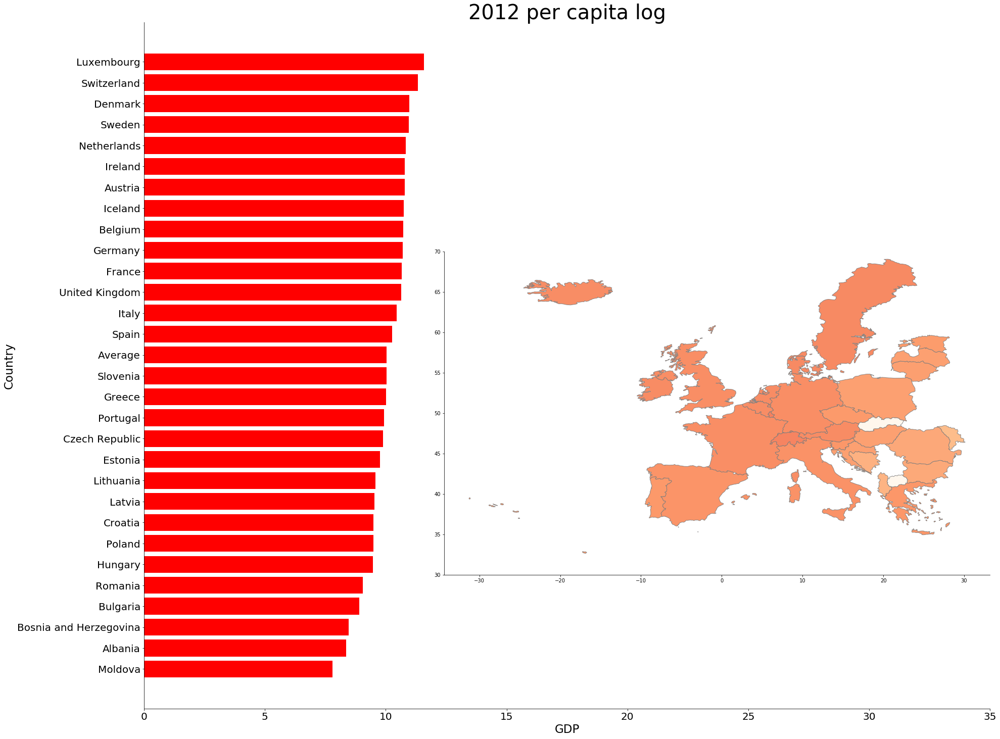

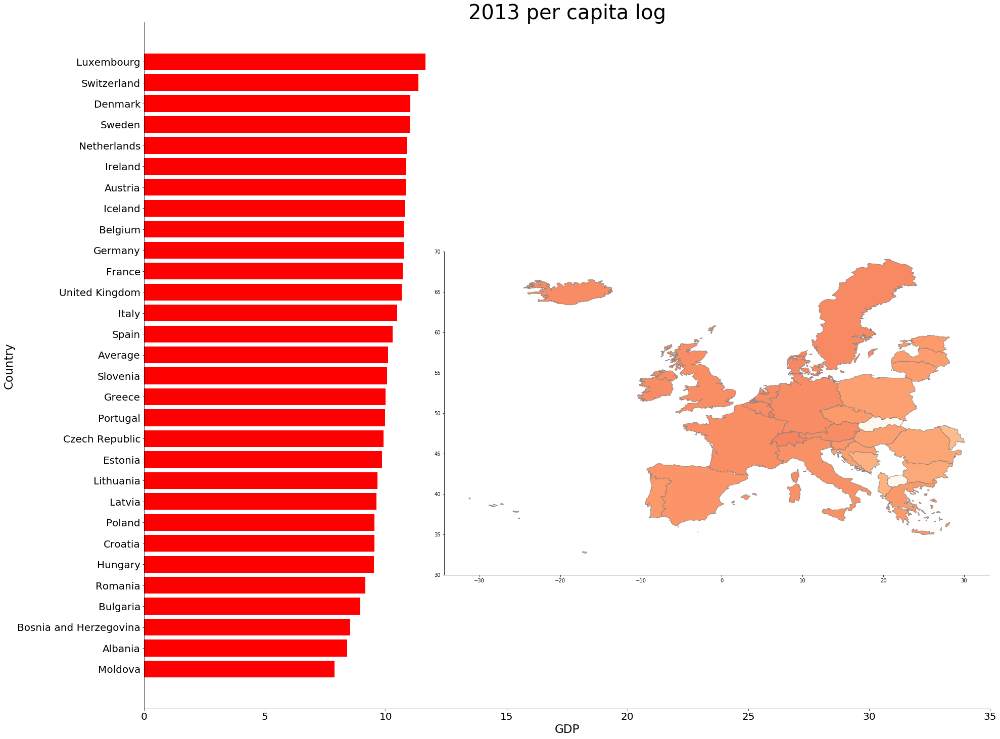

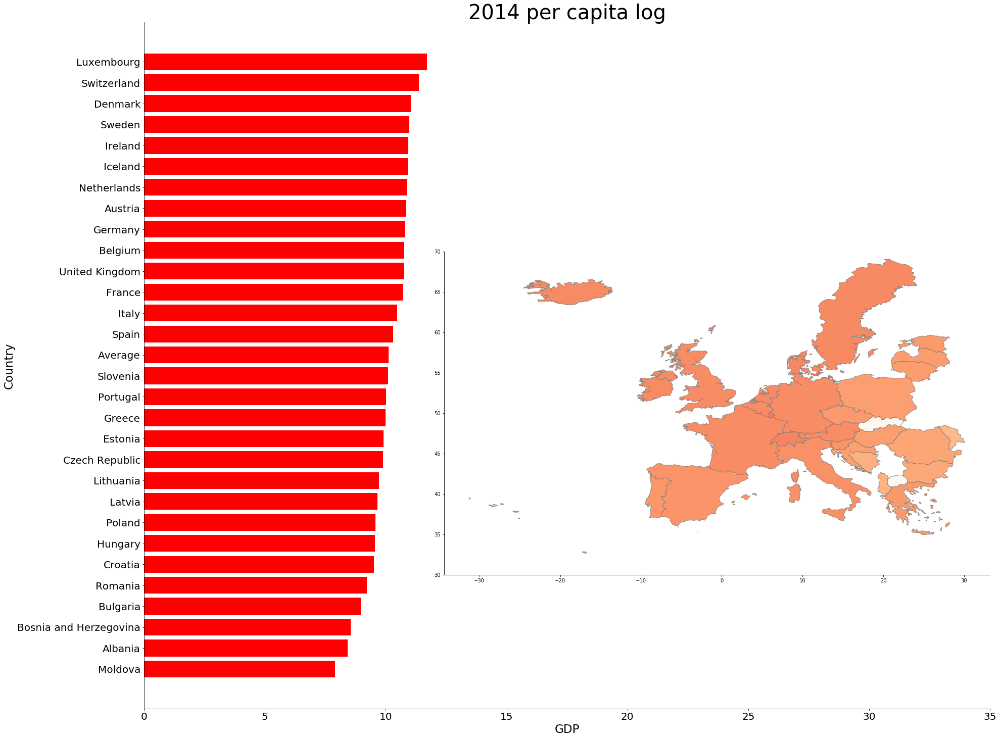

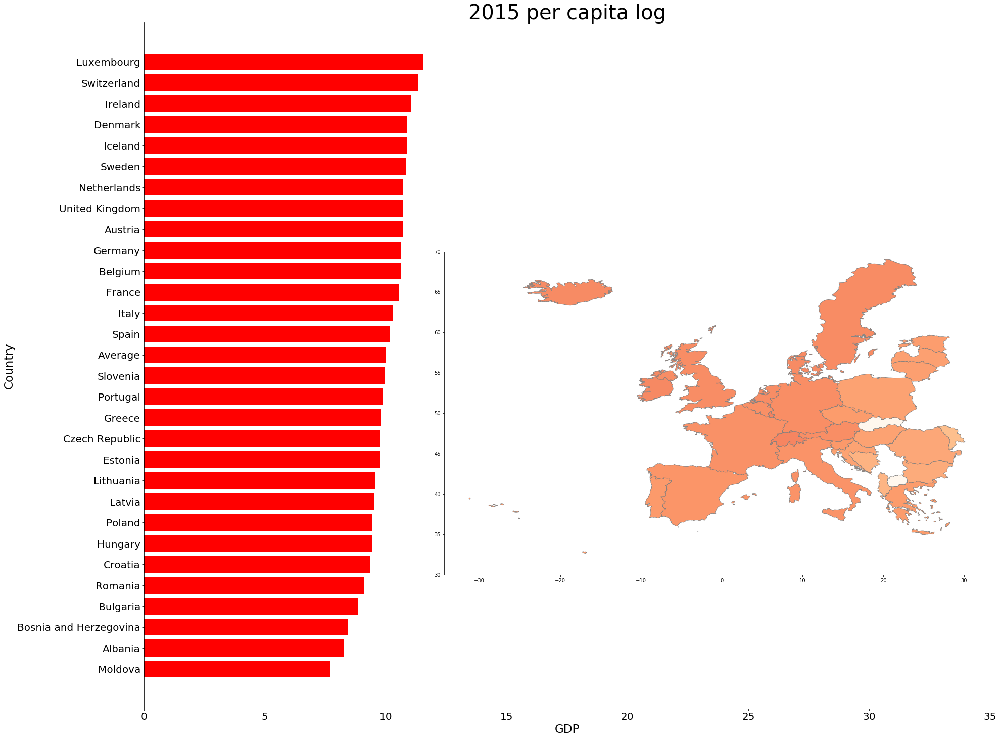

In [81]:
for year in year_per_capita_log_list:
    sort_barchart(year)
    final_plot(year, 20,35)

In [82]:
per_capita_log_pic_list = []

for year in year_per_capita_log_list:
    per_capita_log_pic_list.append(str(year)+".png")

In [83]:
pclimages = []

In [84]:
for filename in per_capita_log_pic_list:
    pclimages.append(imageio.imread(os.getcwd() + "/FinalOutput/" + filename))
    imageio.mimsave(finaloutputpercapitaloggif, pclimages, duration = 1)